Run on NERSC

In [1]:
from __future__ import division, print_function
import sys, os, glob, time, warnings, gc
import matplotlib.pyplot as plt
import numpy as np
from astropy.table import Table, vstack, hstack
import fitsio
from astropy.io import fits
import healpy as hp
from astropy import wcs
# import tarfile

sys.path.append(os.path.expanduser('~/git/Python/user_modules/'))
import match_coord

In [2]:
params = {'legend.fontsize': 'large',
         'axes.labelsize': 'large',
         'axes.titlesize':'large',
         'xtick.labelsize':'large',
         'ytick.labelsize':'large',
         'figure.facecolor':'w'} 
plt.rcParams.update(params)

In [3]:
def plot_cutout(img, pixscale, decraoff=None, vmin=-1, vmax=1, unit='arcsec', axis_label=None, colorbar=False, cbar_label=None, title=None, axis=None, figsize=(8, 8)):
    '''
    decraoff: [dec_offset, ra_offset]
    '''
    if unit=='arcsec':
        rescale = 1.
    elif unit=='arcmin':
        rescale = 60.
    elif unit=='deg':
        rescale = 3600.
    else:
        raise ValueError('unrecognized unit')
    extent = 0.5*pixscale*(img.shape[1]*np.array([-1, 1, 0, 0])+img.shape[0]*np.array([0, 0, -1, 1]))/rescale

    if decraoff is not None:
        dec_offset, ra_offset = decraoff
        extent[0] -= dec_offset # DEC
        extent[1] -= dec_offset # DEC
        extent[2] += ra_offset # RA
        extent[3] += ra_offset # RA
    
    fig, ax = plt.subplots(figsize=figsize)
    dens = ax.imshow(img, aspect='equal',
               cmap='seismic', extent=extent, vmin=vmin, vmax=vmax)
    ax.axvline(0, ls='--', lw=0.5, color='grey')
    ax.axhline(0, ls='--', lw=0.5, color='grey')
    if colorbar:
        cbar = fig.colorbar(dens, fraction=0.046, pad=0.04)
    if cbar_label is not None:
        cbar.ax.set_ylabel(cbar_label)
    ax.grid(alpha=0.5)
    if axis_label is not None:
        ax.set_xlabel(axis_label[0])
        ax.set_ylabel(axis_label[1])
    if title is not None:
        ax.set_title(title)
    if axis is not None:
        ax.axis(axis)
    return ax

def plot_cutout_sidebyside(img1, img2, pixscale, decraoff=None, vmin=-1, vmax=1, unit='arcsec', axis_label=None, axis=None, title1=None, title2=None, figsize=(20, 10), crosshair=True, grid=False):
    '''
    decraoff: [dec_offset, ra_offset]
    '''
    if unit=='arcsec':
        rescale = 1.
    elif unit=='arcmin':
        rescale = 60.
    elif unit=='deg':
        rescale = 3600.
    else:
        raise ValueError('unrecognized unit')
    extent = 0.5*pixscale*(img1.shape[1]*np.array([-1, 1, 0, 0])+img1.shape[0]*np.array([0, 0, -1, 1]))/rescale

    if decraoff is not None:
        dec_offset, ra_offset = decraoff
        extent[0] -= dec_offset # DEC
        extent[1] -= dec_offset # DEC
        extent[2] += ra_offset # RA
        extent[3] += ra_offset # RA
    
    fig, axes = plt.subplots(1, 2, figsize=figsize)
    axes[0].imshow(img1, aspect='equal', 
               cmap='seismic', extent=extent, vmin=vmin, vmax=vmax)
    if crosshair:
        axes[0].axvline(0, ls='--', lw=0.5, color='grey')
        axes[0].axhline(0, ls='--', lw=0.5, color='grey')
    if title1 is not None:
        axes[0].set_title(title1)
    im = axes[1].imshow(img2, aspect='equal', 
               cmap='seismic', extent=extent, vmin=vmin, vmax=vmax)
    axes[1].axvline(0, ls='--', lw=0.5, color='grey')
    axes[1].axhline(0, ls='--', lw=0.5, color='grey')
    if title2 is not None:
        axes[1].set_title(title2)
    if axis_label is not None:
        axes[0].set_xlabel(axis_label[0])
        axes[0].set_ylabel(axis_label[1])
        axes[1].set_xlabel(axis_label[0])
        axes[1].set_ylabel(axis_label[1])
    # fig.colorbar(im, fraction=0.046, pad=0.04)
    if grid:
        axes[0].grid(alpha=0.5)
        axes[1].grid(alpha=0.5)
    if axis is not None:
        axes[0].axis(axis)
        axes[1].axis(axis)
    return axes

In [4]:
from scipy.optimize import curve_fit

def get_frac_moffat(r, alpha, beta):
    """
    Calculate the fraction of light within radius r of a Moffat profile.
    """    
    frac = 1 - alpha**(2*(beta-1))*(alpha**2 + r**2)**(1-beta)
    return(frac)

def get_sb_moffat(r, alpha, beta):
    """
    Calculate the surface brightness of light at radius r of a Moffat profile.
    The integral (i.e., total flux) is unity by definition.
    """
    i = (beta-1)/(np.pi * alpha**2)*(1 + (r/alpha)**2)**(-beta)
    return i

def get_sb_moffat_plus_power_law(r, alpha1, beta1, plexp2, weight2):
    """
    Calculate the surface brightness of light at radius r of the sum of two Moffat profiles.
    The integral (i.e., total flux) is NOT unity.
    """
    i = (beta1-1)/(np.pi * alpha1**2)*(1 + (r/alpha1)**2)**(-beta1) \
        + weight2 *r**(plexp2)
    return i

def get_sb_double_moffat(r, alpha1, beta1, alpha2, beta2, weight2):
    """
    Calculate the surface brightness of light at radius r of the sum of two Moffat profiles.
    The integral (i.e., total flux) is NOT unity.
    """
    i = (beta1-1)/(np.pi * alpha1**2)*(1 + (r/alpha1)**2)**(-beta1) \
        + weight2 * (beta2-1)/(np.pi * alpha2**2)*(1 + (r/alpha2)**2)**(-beta2)
    return i

In [5]:
params = {
'g_weight2': 0.00045, 'g_plexp2': -2.,
'r_weight2': 0.00033, 'r_plexp2': -2.,
'z_alpha2': 17.650, 'z_beta2': 1.7, 'z_weight2': 0.0145,
}

outlier_ccd_list = ['N20', 'S8', 'S10', 'S18', 'S21', 'S27']
params_outlier = {'z_alpha2': 16, 'z_beta2': 2.3, 'z_weight2': 0.0095}

band = 'z'
field = 'south'
region_name = 'decals_ngc'
pixscale = 0.262

vrange = 0.4

        5         4         3         2
0.3298 x - 2.062 x + 4.241 x - 2.969 x - 3.015 x - 2.337
0.560139668507


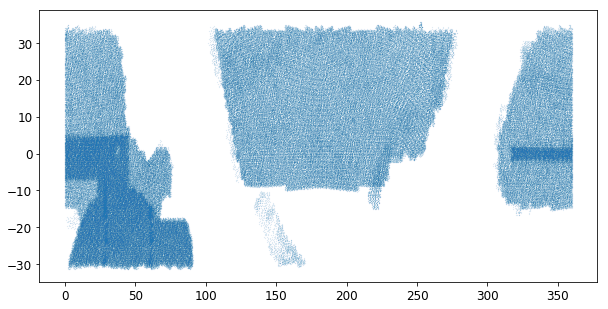

In [6]:
# PSF profile of a 22.5 mag star (in nmgy/pixel)
tmp = np.loadtxt('../data/{}_poly_fit.txt'.format(region_name))
band_index = np.where(band==np.array(['g', 'r', 'z']))[0][0]
poly = np.poly1d(tmp[band_index])
print(poly)
profile_fit = np.poly1d(poly)

# ccd_columns = ['image_filename', 'image_hdu', 'camera', 'expnum', 'ccdname', 'filter', 'fwhm', 'ra', 'dec', 'ccd_cuts', 'ccdzpt', 'exptime', 'ccdskycounts', 'ccdskysb']
ccd_columns = ['image_filename', 'image_hdu', 'camera', 'expnum', 'ccdname', 'filter', 'fwhm', 'ra', 'dec', 'ccd_cuts', 'ccdzpt', 'exptime', 'ccdraoff', 'ccddecoff']

surveyccd_path = '/global/project/projectdirs/cosmo/work/legacysurvey/dr9/survey-ccds-decam-dr9-cut.fits.gz'
# annotatedccd_path = '/global/project/projectdirs/cosmo/work/legacysurvey/dr9/reorg/decam/ccds-annotated-decam-dr9-newlocs2.fits.gz'
# surveyccd_dir = '/Users/rongpu/Documents/Data/desi_misc/dr8'

if field=='south':
    ccd = fitsio.read(surveyccd_path, columns=ccd_columns)
#     accd = fitsio.read(annotatedccd_path, columns=['meansky'])
# elif field=='north' and band=='z':
#     ccd = fitsio.read(os.path.join(surveyccd_dir, 'survey-ccds-mosaic-dr8.fits.gz'), columns=ccd_columns)
# elif field=='north' and (band=='g' or band=='r'):
#     ccd = fitsio.read(os.path.join(surveyccd_dir, 'survey-ccds-90prime-dr8.fits.gz'), columns=ccd_columns)
else:
    raise ValueError

ccd = Table(ccd)
# accd = Table(accd)
# ccd = hstack([ccd, accd])
mask = ccd['ccd_cuts']==0
print(np.sum(mask)/len(mask))
ccd = ccd[mask]

plt.figure(figsize=(10, 5))
plt.plot(ccd['ra'][::10], ccd['dec'][::10], '.', ms=0.1)
plt.show()

gaia = Table.read('/global/homes/r/rongpu/notebooks/bright_star_profiles/data/gaia_sample_for_ccd_cutouts-decals_ngc.fits')

In [7]:
# maximum RA, Dec separation for DECam CCDs
max_d_ra, max_d_dec = 4096*0.262/2, 2046*0.262/2
# max_d_ra, max_d_dec = max_d_ra*0.95, max_d_dec*0.95 # trim CCD edges

idx1_all, idx2_all, d2d, d_ra, d_dec = match_coord.search_around(gaia['ra'], gaia['dec'], ccd['ra'], ccd['dec'], search_radius=max(1.2*max_d_ra, 1.2*max_d_dec))

4958 nearby objects


The history saving thread hit an unexpected error (OperationalError('database is locked',)).History will not be written to the database.
152
52
202.306688687 3.87139609372
2   phot_g_mean_mag=6.638   ls_z=5.761
1 CCD images available
alpha, beta = 0.830, 2.458


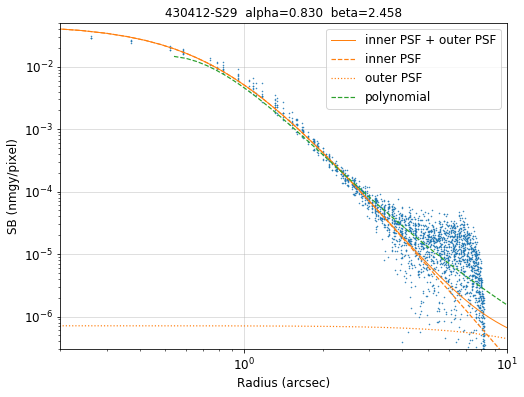

Exposure: 430412  CCD: S29


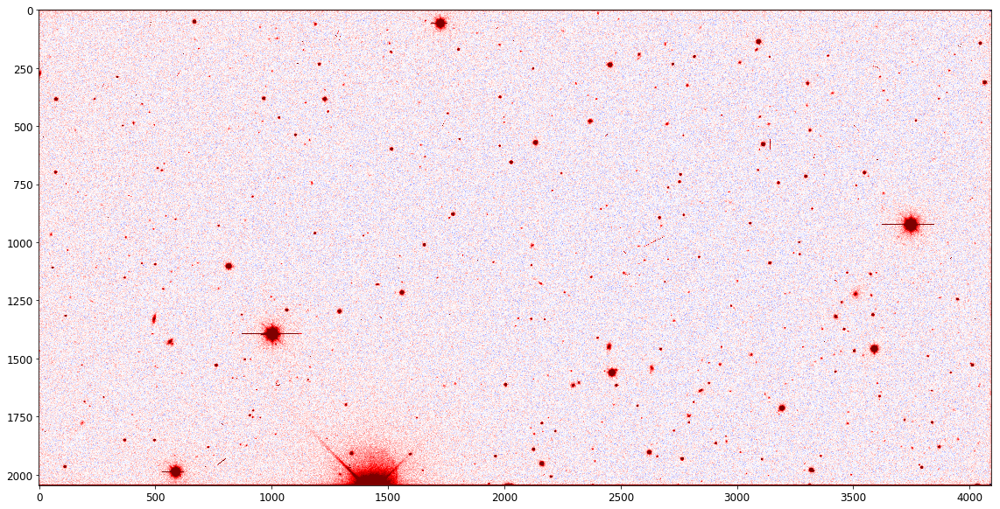

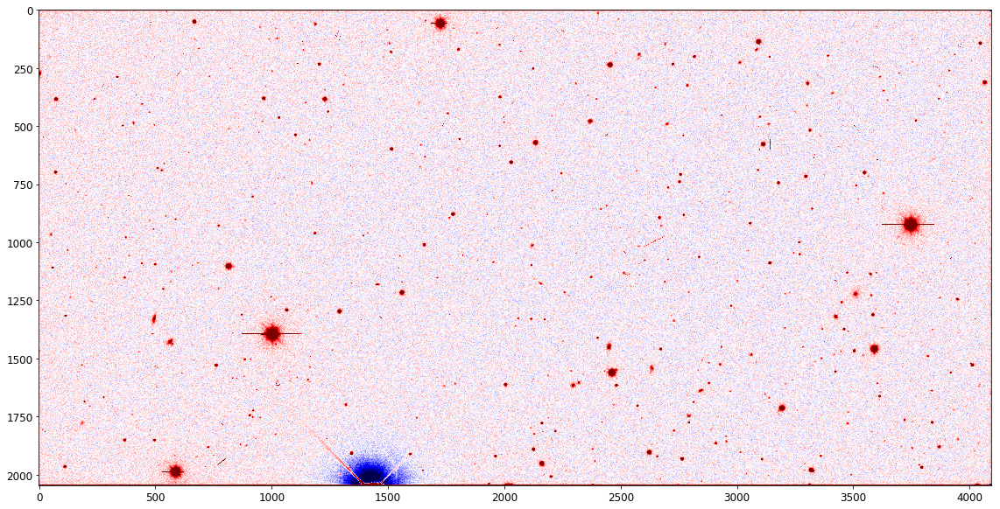

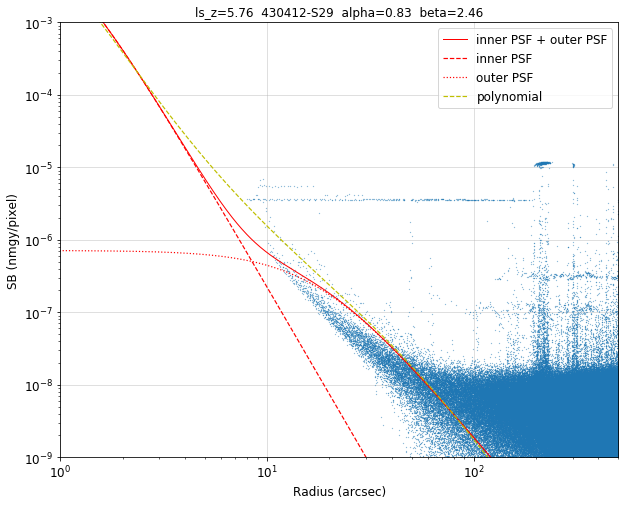

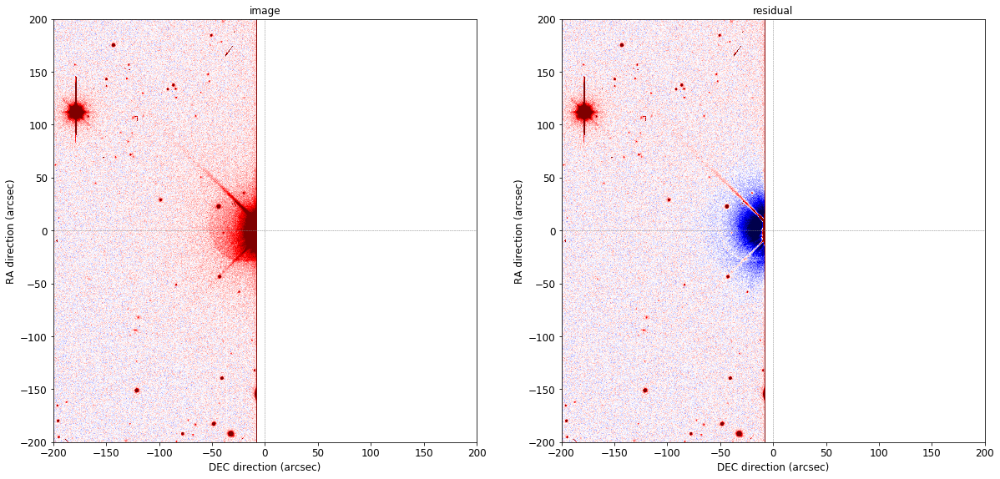

In [8]:
mask = (np.abs(d_ra)<max_d_ra)
mask &= (np.abs(d_dec)>1.0*max_d_dec) & (np.abs(d_dec)<1.07*max_d_dec)
print(np.sum(mask))
mask &= ccd['filter'][idx2_all]==band
print(np.sum(mask))
idx1 = idx1_all[mask]
idx2 = idx2_all[mask]

gaia_index = idx1[1]
ccd1_index = 0

gaia_mask = idx1==gaia_index
if np.sum(gaia_mask)==0:
    raise ValueError

ra, dec = gaia['ra'][gaia_index], gaia['dec'][gaia_index]
print(ra, dec)
print('{}   phot_g_mean_mag={:.3f}   ls_{}={:.3f}'.format(gaia_index, gaia['phot_g_mean_mag'][gaia_index], band, gaia['ls_'+band][gaia_index]))

with warnings.catch_warnings():
    warnings.simplefilter("ignore")

    ccd1 = ccd[idx2[gaia_mask]]
    print(len(ccd1), 'CCD images available')

    expnum_str = str(ccd1['expnum'][ccd1_index])
    ccdname = ccd1['ccdname'][ccd1_index]
    fn_prefix = ccd1['camera'][ccd1_index]+'-'+(5-len(expnum_str[:3]))*'0'+expnum_str+'-'+ccdname
    # print(fn_prefix)
    # print('seeing = {:.2f} arcsec'.format(ccd1['seeing'][ccd1_index]))
    # print('airmass = {:.2f}'.format(ccd1['airmass'][ccd1_index]))

    if band=='z' and (ccdname in outlier_ccd_list):
        params_to_use = params_outlier
    else:
        params_to_use = params

    if band!='z':
        plexp2, weight2 = params_to_use[band+'_plexp2'], params_to_use[band+'_weight2']
    else:
        alpha2, beta2, weight2 = params_to_use[band+'_alpha2'], params_to_use[band+'_beta2'],  params_to_use[band+'_weight2']
    
    ########## PSFEx ###########
    image_filename = ccd1['image_filename'][ccd1_index]
    psfex_filename = image_filename[:image_filename.find('.fits.fz')]+'-psfex.fits'
    psfex_fn = os.path.join('/project/projectdirs/cosmo/work/legacysurvey/dr9/calib', psfex_filename)

    hdu = fits.open(psfex_fn)
    data = hdu[1].data
    psfex_index = np.where(data['ccdname']==ccdname)[0][0]

    psf0 = data['psf_mask'][psfex_index, 0]
    # normalize to a 22.5 magnitude star
    psf0 = psf0/np.sum(psf0)

    # vrange = 0.0002
    # ax = plot_cutout(psf0, pixscale, vmin=-vrange, vmax=vrange, axis_label=['DEC direction (arcsec)', 'RA direction (arcsec)'])
    # plt.show()

    grid = pixscale * np.linspace(-0.5*(psf0.shape[0]-1), 0.5*(psf0.shape[0]-1), psf0.shape[0])
    xx, yy = np.meshgrid(grid, grid)
    radius_grid = np.sqrt(xx**2 + yy**2)
    radius = radius_grid.flatten()

    ################# Moffat fit ##############

    radius_min, radius_max = 1.8, 5.0

    psf0_flat = psf0.flatten()
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        # popt, pcov =  curve_fit(get_sb_moffat, radius, psf0_flat/(pixscale**2))
        mask = (radius>radius_min) & (radius<radius_max)
        popt, pcov = curve_fit(get_sb_moffat, radius[mask], psf0_flat[mask]/(pixscale**2), bounds=((0, 1.8), np.inf))

    alpha, beta = popt
    print('alpha, beta = {:.3f}, {:.3f}'.format(alpha, beta))
    
    radius_plot = np.linspace(0, 30, 500)
    if band!='z':
        psf_predict = pixscale**2 * get_sb_moffat_plus_power_law(radius_grid, alpha, beta, plexp2, weight2)
        psf_plot = pixscale**2 * get_sb_moffat_plus_power_law(radius_plot, alpha, beta, plexp2, weight2)
        psf_plot1 = pixscale**2 * get_sb_moffat(radius_plot, alpha, beta)
        psf_plot2 = weight2 * pixscale**2 * radius_plot**(plexp2)
    else:
        psf_predict = pixscale**2 * get_sb_double_moffat(radius_grid, alpha, beta, alpha2, beta2, weight2)
        psf_plot = pixscale**2 * get_sb_double_moffat(radius_plot, alpha, beta, alpha2, beta2, weight2)
        psf_plot1 = pixscale**2 * get_sb_moffat(radius_plot, alpha, beta)
        psf_plot2 = weight2 * pixscale**2 * get_sb_moffat(radius_plot, alpha2, beta2)

    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        plt.figure(figsize=(8, 6))
        plt.loglog(radius, psf0_flat, '.', ms=1.)
        plt.loglog(radius_plot, psf_plot, 'C1-', lw=1, label='inner PSF + outer PSF')
        plt.loglog(radius_plot, psf_plot1, 'C1--', lw=1.2, alpha=1., label='inner PSF')
        plt.loglog(radius_plot, psf_plot2, 'C1:', lw=1.2, alpha=1., label='outer PSF')
        mask = radius_plot>0.5
        plt.loglog(radius_plot[mask], 10**(profile_fit(np.log10(radius_plot)))[mask], 'C2--', lw=1.2, label='polynomial')
        plt.axis([0.2, 10, 3e-7, 0.05])
        plt.grid(alpha=0.5)
        plt.xlabel('Radius (arcsec)')
        plt.ylabel('SB (nmgy/pixel)')
        plt.title('{}-{}  alpha={:.3f}  beta={:.3f}'.format(expnum_str, ccdname, alpha, beta))
        plt.legend()
        # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_psfex.png'.format(band, band, gaia_index, ccd1_index, ccdname))
        plt.show()

    ######################################################

    image_dir = '/global/project/projectdirs/cosmo/staging/'
    fn = os.path.join(image_dir, ccd1['image_filename'][ccd1_index]).strip()
    # print(fn)

    hdulist = fits.open(fn)
    # print(hdu[ccd1['image_hdu'][ccd1_index]].header)
    img_raw = hdulist[ccd1['image_hdu'][ccd1_index]].data

    # naive sky subtraction
    mask = (img_raw<np.percentile(img_raw.flatten(), 85))
    img = img_raw - np.median(img_raw[mask].flatten())
    # convert to nanomaggie per pixel
    img = img / 10**((ccd1['ccdzpt'][ccd1_index]-22.5)/2.5) / ccd1['exptime'][ccd1_index]

    # plt.hist(img.flatten(), 100, range=(-0.02, 0.02))
    # plt.axvline(0, color='red')
    # plt.show()

    xgrid = pixscale * np.linspace(-0.5*(img.shape[1]-1), 0.5*(img.shape[1]-1), img.shape[1])
    ygrid = pixscale * np.linspace(-0.5*(img.shape[0]-1), 0.5*(img.shape[0]-1), img.shape[0])
    xx, yy = np.meshgrid(xgrid, ygrid)

    # astrometric correction
    ccdraoff, ccddecoff = -ccd1['ccdraoff'][ccd1_index], -ccd1['ccddecoff'][ccd1_index]

    w = wcs.WCS(hdulist[ccd1['image_hdu'][ccd1_index]].header)
    xpixcenter, ypixcenter = w.wcs_world2pix([[ra, dec]], True)[0]
    # if (xpixcenter<0) or (ypixcenter<0) or (xpixcenter>img.shape[1]) or (ypixcenter>img.shape[0]):
    #     raise ValueError ('outside the CCD!!!')
        # print('outside the CCD!!!')
        # continue

    print('Exposure: {}  CCD: {}'.format(expnum_str, ccdname))

    ccddecoff += pixscale*(xpixcenter-(img.shape[1]/2+0.5))
    ccdraoff += pixscale*(ypixcenter-(img.shape[0]/2+0.5))

    xx, yy = xx - ccddecoff, yy - ccdraoff

    radius_grid = np.sqrt(xx**2 + yy**2)
    radius = radius_grid.flatten()
    radius_plot = np.logspace(-1, 3, 1000)
    flux = img.flatten()
    # normalization of a 22.5 magnitude star
    norm_factor =  10**((gaia['ls_'+band][gaia_index]-22.5)/2.5)
    
    if band!='z':
        img_predict = pixscale**2 * get_sb_moffat_plus_power_law(radius_grid, alpha, beta, plexp2, weight2) / norm_factor
        flux_plot = pixscale**2 * get_sb_moffat_plus_power_law(radius_plot, alpha, beta, plexp2, weight2)
        flux_plot1 = pixscale**2 * get_sb_moffat(radius_plot, alpha, beta)
        flux_plot2 = weight2 * pixscale**2 * radius_plot**(plexp2)
    else:
        img_predict = pixscale**2 * get_sb_double_moffat(radius_grid, alpha, beta, alpha2, beta2, weight2) / norm_factor
        flux_plot = pixscale**2 * get_sb_double_moffat(radius_plot, alpha, beta, alpha2, beta2, weight2)
        flux_plot1 = pixscale**2 * get_sb_moffat(radius_plot, alpha, beta)
        flux_plot2 = weight2 * pixscale**2 * get_sb_moffat(radius_plot, alpha2, beta2)

    plt.figure(figsize=(20, 10))
    plt.imshow(img.T, cmap='seismic', vmin=-vrange, vmax=vrange)
    # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_img.png'.format(band, band, gaia_index, ccd1_index, ccdname))
    plt.show()

    plt.figure(figsize=(20, 10))
    plt.imshow((img-img_predict).T, cmap='seismic', vmin=-vrange, vmax=vrange)
    # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_img_subtr.png'.format(band, band, gaia_index, ccd1_index, ccdname))
    plt.show()

    mask = radius<500
    plt.figure(figsize=(10, 8))
    plt.loglog((radius[mask])[::10], norm_factor*(flux[mask])[::10], '.', ms=0.4)
    plt.loglog(radius_plot, flux_plot, 'r-', lw=1, label='inner PSF + outer PSF')
    plt.loglog(radius_plot, flux_plot1, 'r--', lw=1.2, alpha=1., label='inner PSF')
    plt.loglog(radius_plot, flux_plot2, 'r:', lw=1.2, alpha=1., label='outer PSF')
    mask = radius_plot>0.5
    plt.loglog(radius_plot[mask], 10**(profile_fit(np.log10(radius_plot[mask]))), 'y--', lw=1.2, label='polynomial')
    plt.axis([1, 500, 1e-9, 1e-3])
    plt.grid(alpha=0.5)
    plt.title('ls_{}={:.2f}  {}-{}  alpha={:.2f}  beta={:.2f}'.format(band, gaia['ls_'+band][gaia_index], expnum_str, ccdname, alpha, beta))
    plt.xlabel('Radius (arcsec)')
    plt.ylabel('SB (nmgy/pixel)')
    plt.legend()
    # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_profile.png'.format(band, band, gaia_index, ccd1_index, ccdname))
    plt.show()

    ax = plot_cutout_sidebyside(img, img-img_predict, pixscale, decraoff=[ccddecoff, ccdraoff], vmin=-vrange, vmax=vrange, axis_label=['DEC direction (arcsec)', 'RA direction (arcsec)'], axis=[-200, 200, -200, 200], title1='image', title2='residual')
    # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_sidebyside.png'.format(band, band, gaia_index, ccd1_index, ccdname))
    plt.show()

---------

2199
737
198.338561455 -3.49457794573
0   phot_g_mean_mag=6.806   ls_z=5.987
3 CCD images available
alpha, beta = 1.150, 2.254


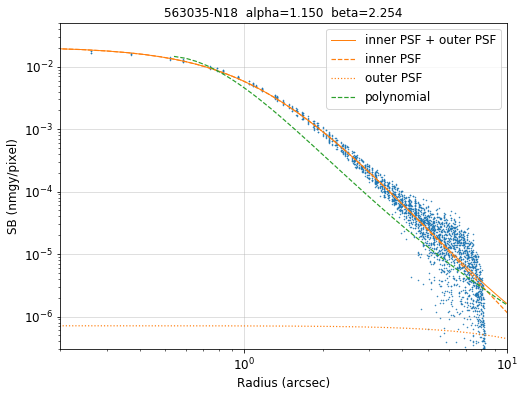

Exposure: 563035  CCD: N18


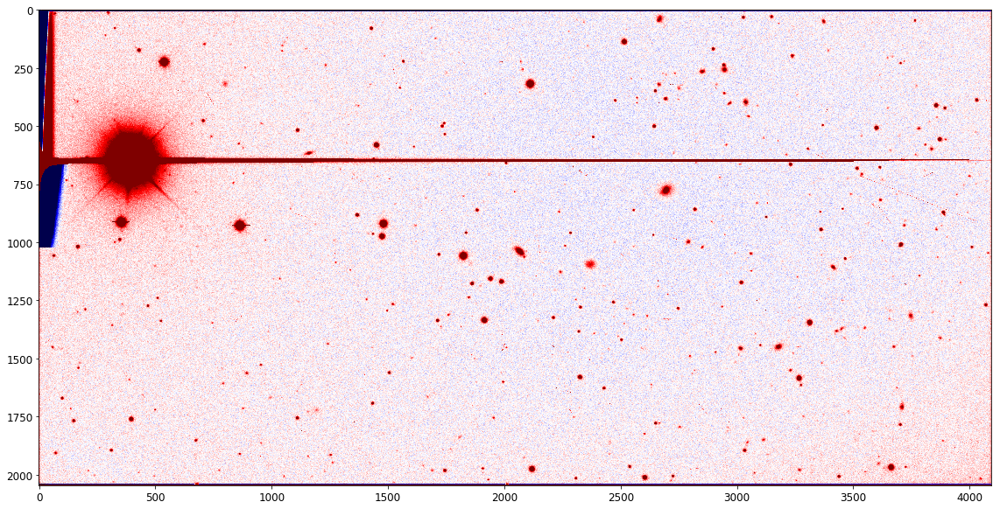

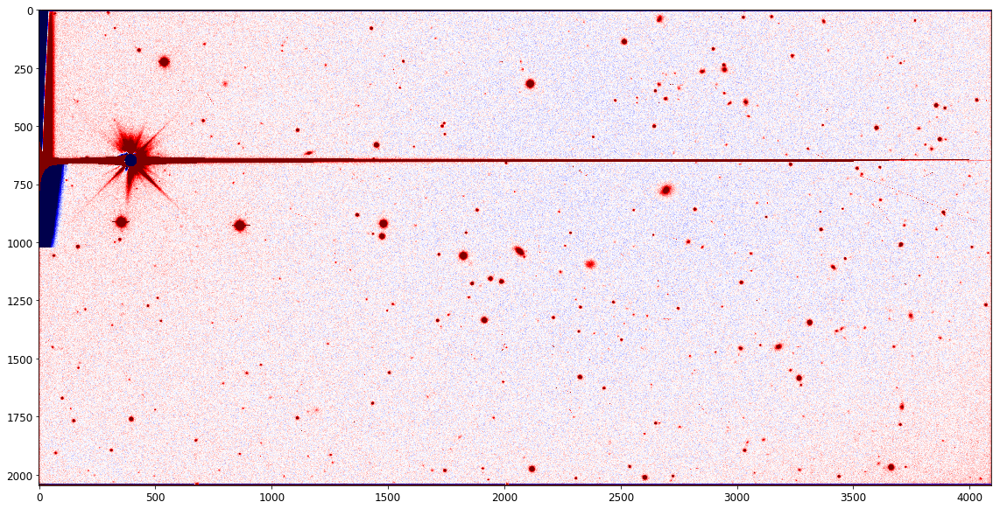

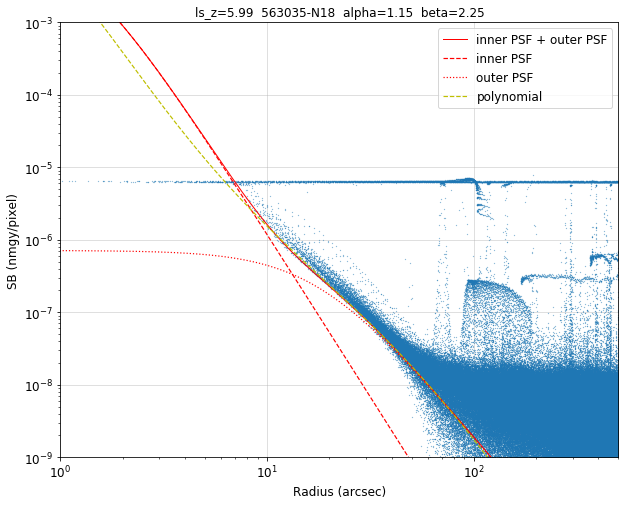

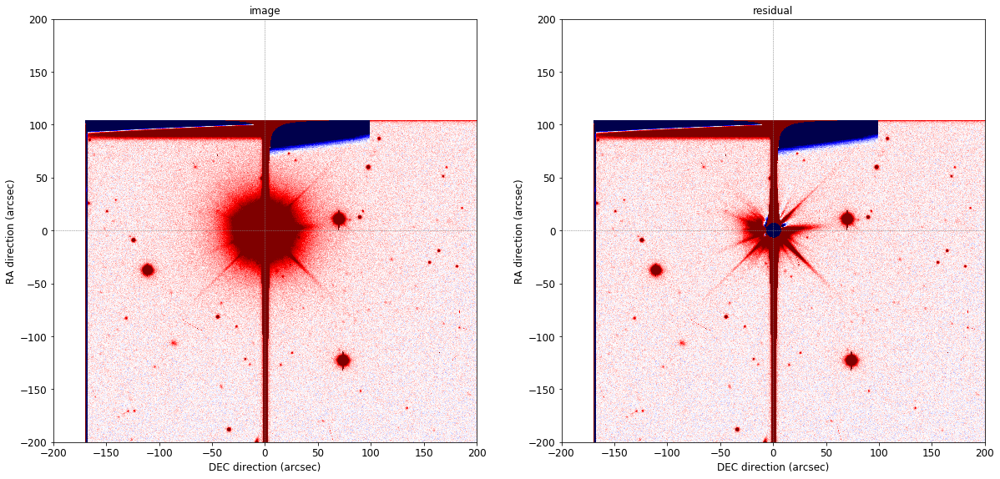

In [9]:
mask = np.abs(d_ra)<max_d_ra
mask &= np.abs(d_dec)<max_d_dec
print(np.sum(mask))
mask &= ccd['filter'][idx2_all]==band
print(np.sum(mask))
idx1_within = idx1_all[mask]
idx2_within = idx2_all[mask]

gaia_index = idx1[0]
ccd1_index = 0

gaia_mask = idx1_within==gaia_index
if np.sum(gaia_mask)==0:
    raise ValueError

ra, dec = gaia['ra'][gaia_index], gaia['dec'][gaia_index]
print(ra, dec)
print('{}   phot_g_mean_mag={:.3f}   ls_{}={:.3f}'.format(gaia_index, gaia['phot_g_mean_mag'][gaia_index], band, gaia['ls_'+band][gaia_index]))

with warnings.catch_warnings():
    warnings.simplefilter("ignore")

    ccd1 = ccd[idx2_within[gaia_mask]]
    print(len(ccd1), 'CCD images available')

    expnum_str = str(ccd1['expnum'][ccd1_index])
    ccdname = ccd1['ccdname'][ccd1_index]
    fn_prefix = ccd1['camera'][ccd1_index]+'-'+(5-len(expnum_str[:3]))*'0'+expnum_str+'-'+ccdname
    # print(fn_prefix)
    # print('seeing = {:.2f} arcsec'.format(ccd1['seeing'][ccd1_index]))
    # print('airmass = {:.2f}'.format(ccd1['airmass'][ccd1_index]))

    if band=='z' and (ccdname in outlier_ccd_list):
        params_to_use = params_outlier
    else:
        params_to_use = params

    if band!='z':
        plexp2, weight2 = params_to_use[band+'_plexp2'], params_to_use[band+'_weight2']
    else:
        alpha2, beta2, weight2 = params_to_use[band+'_alpha2'], params_to_use[band+'_beta2'],  params_to_use[band+'_weight2']
    
    ########## PSFEx ###########
    image_filename = ccd1['image_filename'][ccd1_index]
    psfex_filename = image_filename[:image_filename.find('.fits.fz')]+'-psfex.fits'
    psfex_fn = os.path.join('/project/projectdirs/cosmo/work/legacysurvey/dr9/calib', psfex_filename)

    hdu = fits.open(psfex_fn)
    data = hdu[1].data
    psfex_index = np.where(data['ccdname']==ccdname)[0][0]

    psf0 = data['psf_mask'][psfex_index, 0]
    # normalize to a 22.5 magnitude star
    psf0 = psf0/np.sum(psf0)

    # vrange = 0.0002
    # ax = plot_cutout(psf0, pixscale, vmin=-vrange, vmax=vrange, axis_label=['DEC direction (arcsec)', 'RA direction (arcsec)'])
    # plt.show()

    grid = pixscale * np.linspace(-0.5*(psf0.shape[0]-1), 0.5*(psf0.shape[0]-1), psf0.shape[0])
    xx, yy = np.meshgrid(grid, grid)
    radius_grid = np.sqrt(xx**2 + yy**2)
    radius = radius_grid.flatten()

    ################# Moffat fit ##############

    radius_min, radius_max = 1.8, 5.0

    psf0_flat = psf0.flatten()
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        # popt, pcov =  curve_fit(get_sb_moffat, radius, psf0_flat/(pixscale**2))
        mask = (radius>radius_min) & (radius<radius_max)
        popt, pcov = curve_fit(get_sb_moffat, radius[mask], psf0_flat[mask]/(pixscale**2), bounds=((0, 1.8), np.inf))

    alpha, beta = popt
    print('alpha, beta = {:.3f}, {:.3f}'.format(alpha, beta))
    
    radius_plot = np.linspace(0, 30, 500)
    if band!='z':
        psf_predict = pixscale**2 * get_sb_moffat_plus_power_law(radius_grid, alpha, beta, plexp2, weight2)
        psf_plot = pixscale**2 * get_sb_moffat_plus_power_law(radius_plot, alpha, beta, plexp2, weight2)
        psf_plot1 = pixscale**2 * get_sb_moffat(radius_plot, alpha, beta)
        psf_plot2 = weight2 * pixscale**2 * radius_plot**(plexp2)
    else:
        psf_predict = pixscale**2 * get_sb_double_moffat(radius_grid, alpha, beta, alpha2, beta2, weight2)
        psf_plot = pixscale**2 * get_sb_double_moffat(radius_plot, alpha, beta, alpha2, beta2, weight2)
        psf_plot1 = pixscale**2 * get_sb_moffat(radius_plot, alpha, beta)
        psf_plot2 = weight2 * pixscale**2 * get_sb_moffat(radius_plot, alpha2, beta2)

    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        plt.figure(figsize=(8, 6))
        plt.loglog(radius, psf0_flat, '.', ms=1.)
        plt.loglog(radius_plot, psf_plot, 'C1-', lw=1, label='inner PSF + outer PSF')
        plt.loglog(radius_plot, psf_plot1, 'C1--', lw=1.2, alpha=1., label='inner PSF')
        plt.loglog(radius_plot, psf_plot2, 'C1:', lw=1.2, alpha=1., label='outer PSF')
        mask = radius_plot>0.5
        plt.loglog(radius_plot[mask], 10**(profile_fit(np.log10(radius_plot)))[mask], 'C2--', lw=1.2, label='polynomial')
        plt.axis([0.2, 10, 3e-7, 0.05])
        plt.grid(alpha=0.5)
        plt.xlabel('Radius (arcsec)')
        plt.ylabel('SB (nmgy/pixel)')
        plt.title('{}-{}  alpha={:.3f}  beta={:.3f}'.format(expnum_str, ccdname, alpha, beta))
        plt.legend()
        # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_psfex.png'.format(band, band, gaia_index, ccd1_index, ccdname))
        plt.show()

    ######################################################

    image_dir = '/global/project/projectdirs/cosmo/staging/'
    fn = os.path.join(image_dir, ccd1['image_filename'][ccd1_index]).strip()
    # print(fn)

    hdulist = fits.open(fn)
    # print(hdu[ccd1['image_hdu'][ccd1_index]].header)
    img_raw = hdulist[ccd1['image_hdu'][ccd1_index]].data

    # naive sky subtraction
    mask = (img_raw<np.percentile(img_raw.flatten(), 85))
    img = img_raw - np.median(img_raw[mask].flatten())
    # convert to nanomaggie per pixel
    img = img / 10**((ccd1['ccdzpt'][ccd1_index]-22.5)/2.5) / ccd1['exptime'][ccd1_index]

    # plt.hist(img.flatten(), 100, range=(-0.02, 0.02))
    # plt.axvline(0, color='red')
    # plt.show()

    xgrid = pixscale * np.linspace(-0.5*(img.shape[1]-1), 0.5*(img.shape[1]-1), img.shape[1])
    ygrid = pixscale * np.linspace(-0.5*(img.shape[0]-1), 0.5*(img.shape[0]-1), img.shape[0])
    xx, yy = np.meshgrid(xgrid, ygrid)

    # astrometric correction
    ccdraoff, ccddecoff = -ccd1['ccdraoff'][ccd1_index], -ccd1['ccddecoff'][ccd1_index]

    w = wcs.WCS(hdulist[ccd1['image_hdu'][ccd1_index]].header)
    xpixcenter, ypixcenter = w.wcs_world2pix([[ra, dec]], True)[0]
    # if (xpixcenter<0) or (ypixcenter<0) or (xpixcenter>img.shape[1]) or (ypixcenter>img.shape[0]):
    #     raise ValueError ('outside the CCD!!!')
        # print('outside the CCD!!!')
        # continue

    print('Exposure: {}  CCD: {}'.format(expnum_str, ccdname))

    ccddecoff += pixscale*(xpixcenter-(img.shape[1]/2+0.5))
    ccdraoff += pixscale*(ypixcenter-(img.shape[0]/2+0.5))

    xx, yy = xx - ccddecoff, yy - ccdraoff

    radius_grid = np.sqrt(xx**2 + yy**2)
    radius = radius_grid.flatten()
    radius_plot = np.logspace(-1, 3, 1000)
    flux = img.flatten()
    # normalization of a 22.5 magnitude star
    norm_factor =  10**((gaia['ls_'+band][gaia_index]-22.5)/2.5)
    
    if band!='z':
        img_predict = pixscale**2 * get_sb_moffat_plus_power_law(radius_grid, alpha, beta, plexp2, weight2) / norm_factor
        flux_plot = pixscale**2 * get_sb_moffat_plus_power_law(radius_plot, alpha, beta, plexp2, weight2)
        flux_plot1 = pixscale**2 * get_sb_moffat(radius_plot, alpha, beta)
        flux_plot2 = weight2 * pixscale**2 * radius_plot**(plexp2)
    else:
        img_predict = pixscale**2 * get_sb_double_moffat(radius_grid, alpha, beta, alpha2, beta2, weight2) / norm_factor
        flux_plot = pixscale**2 * get_sb_double_moffat(radius_plot, alpha, beta, alpha2, beta2, weight2)
        flux_plot1 = pixscale**2 * get_sb_moffat(radius_plot, alpha, beta)
        flux_plot2 = weight2 * pixscale**2 * get_sb_moffat(radius_plot, alpha2, beta2)

    plt.figure(figsize=(20, 10))
    plt.imshow(img.T, cmap='seismic', vmin=-vrange, vmax=vrange)
    # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_img.png'.format(band, band, gaia_index, ccd1_index, ccdname))
    plt.show()

    plt.figure(figsize=(20, 10))
    plt.imshow((img-img_predict).T, cmap='seismic', vmin=-vrange, vmax=vrange)
    # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_img_subtr.png'.format(band, band, gaia_index, ccd1_index, ccdname))
    plt.show()

    mask = radius<500
    plt.figure(figsize=(10, 8))
    plt.loglog((radius[mask])[::10], norm_factor*(flux[mask])[::10], '.', ms=0.4)
    plt.loglog(radius_plot, flux_plot, 'r-', lw=1, label='inner PSF + outer PSF')
    plt.loglog(radius_plot, flux_plot1, 'r--', lw=1.2, alpha=1., label='inner PSF')
    plt.loglog(radius_plot, flux_plot2, 'r:', lw=1.2, alpha=1., label='outer PSF')
    mask = radius_plot>0.5
    plt.loglog(radius_plot[mask], 10**(profile_fit(np.log10(radius_plot[mask]))), 'y--', lw=1.2, label='polynomial')
    plt.axis([1, 500, 1e-9, 1e-3])
    plt.grid(alpha=0.5)
    plt.title('ls_{}={:.2f}  {}-{}  alpha={:.2f}  beta={:.2f}'.format(band, gaia['ls_'+band][gaia_index], expnum_str, ccdname, alpha, beta))
    plt.xlabel('Radius (arcsec)')
    plt.ylabel('SB (nmgy/pixel)')
    plt.legend()
    # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_profile.png'.format(band, band, gaia_index, ccd1_index, ccdname))
    plt.show()

    ax = plot_cutout_sidebyside(img, img-img_predict, pixscale, decraoff=[ccddecoff, ccdraoff], vmin=-vrange, vmax=vrange, axis_label=['DEC direction (arcsec)', 'RA direction (arcsec)'], axis=[-200, 200, -200, 200], title1='image', title2='residual')
    # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_sidebyside.png'.format(band, band, gaia_index, ccd1_index, ccdname))
    plt.show()

---------

152
52
198.338561455 -3.49457794573
0   phot_g_mean_mag=6.806   ls_z=5.987
1 CCD images available
alpha, beta = 0.491, 1.960
Exposure: 426144  CCD: N14


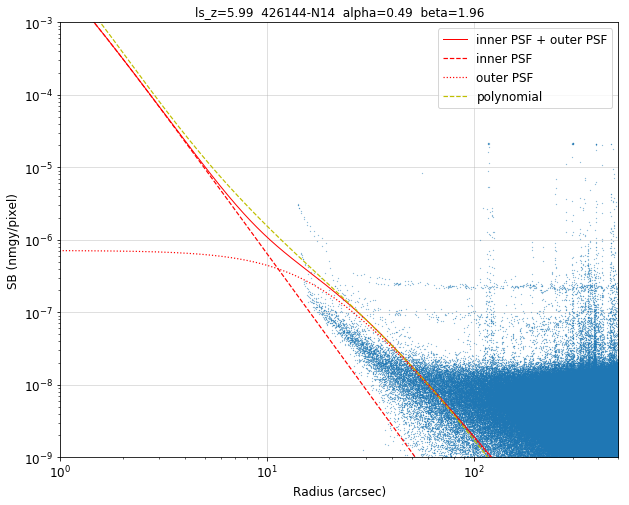

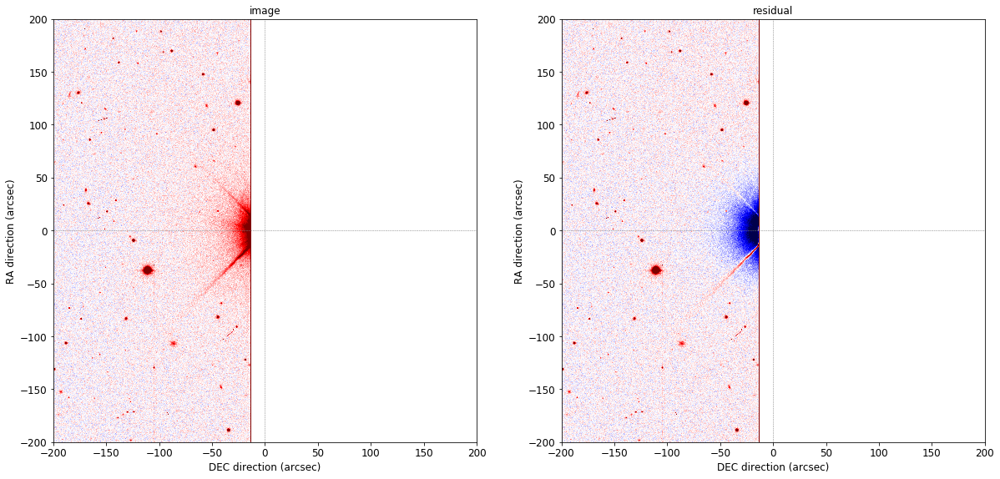

202.306688687 3.87139609372
2   phot_g_mean_mag=6.638   ls_z=5.761
1 CCD images available
alpha, beta = 0.830, 2.458
Exposure: 430412  CCD: S29


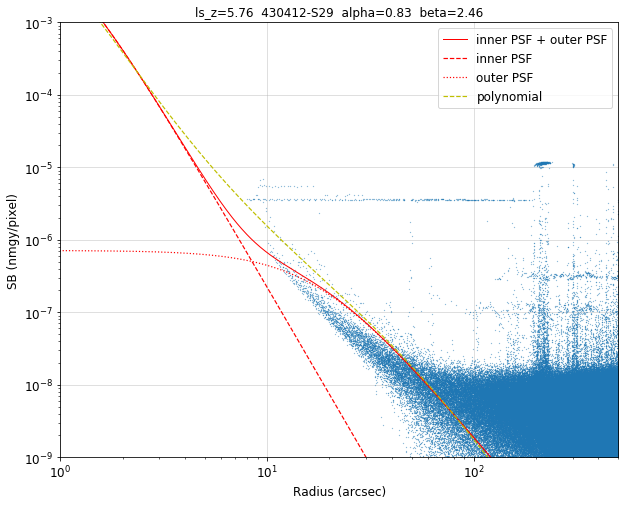

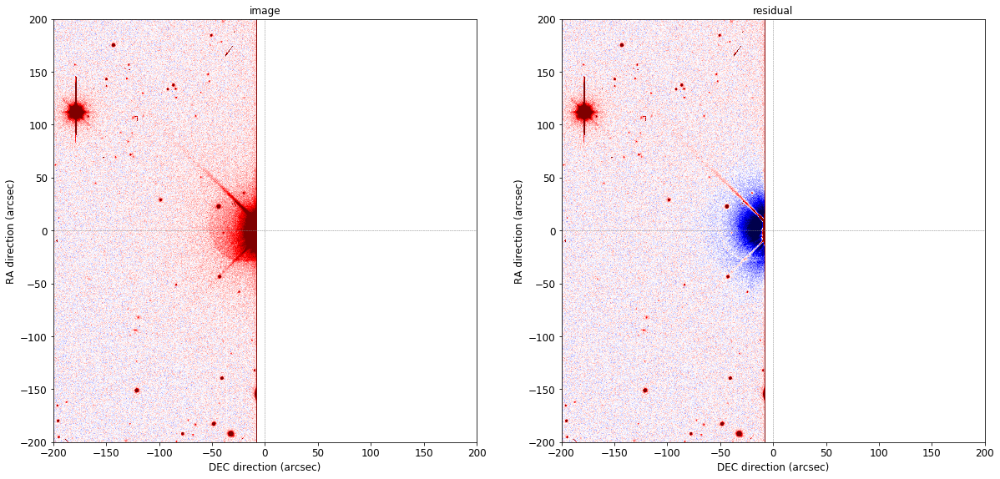

191.38337591 -4.81091928316
4   phot_g_mean_mag=6.772   ls_z=6.115
1 CCD images available
alpha, beta = 0.441, 1.895
Exposure: 716710  CCD: N17


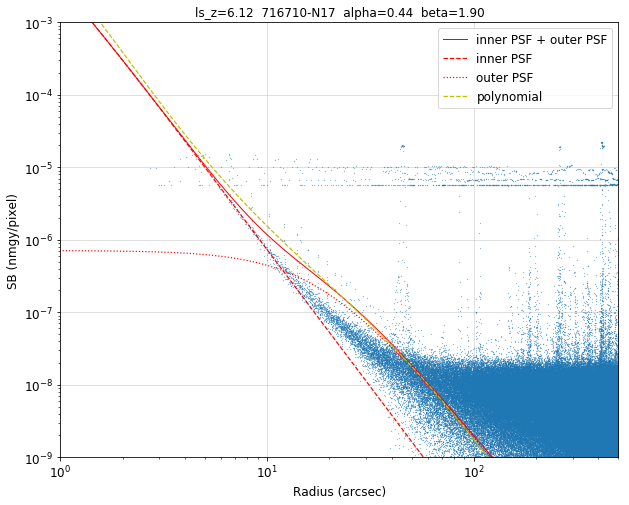

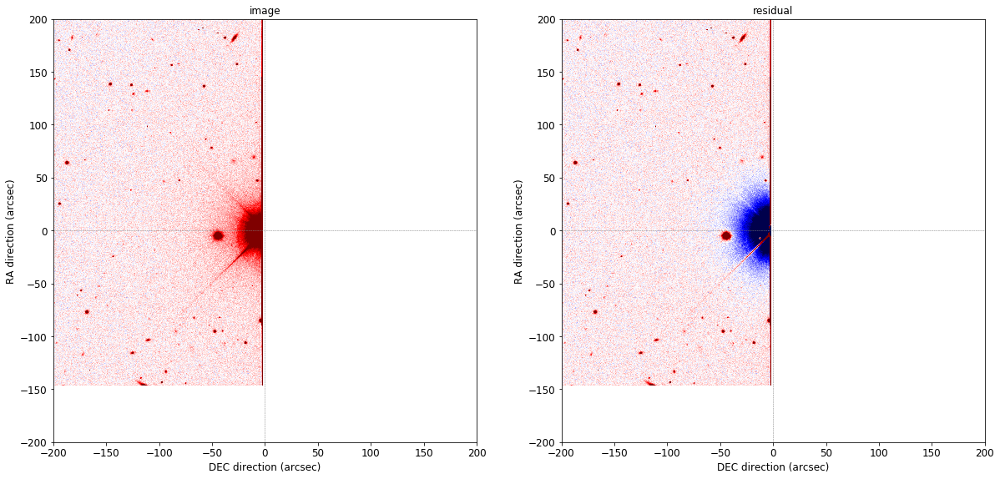

170.81309453 6.58575909154
6   phot_g_mean_mag=6.660   ls_z=6.268
1 CCD images available
alpha, beta = 0.458, 2.081
Exposure: 626380  CCD: S31


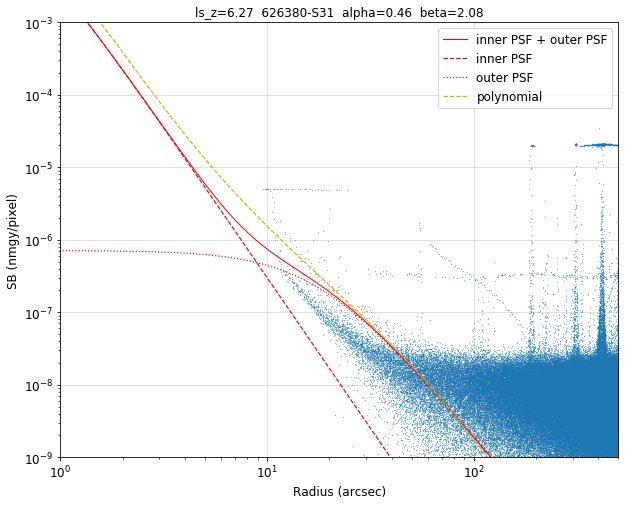

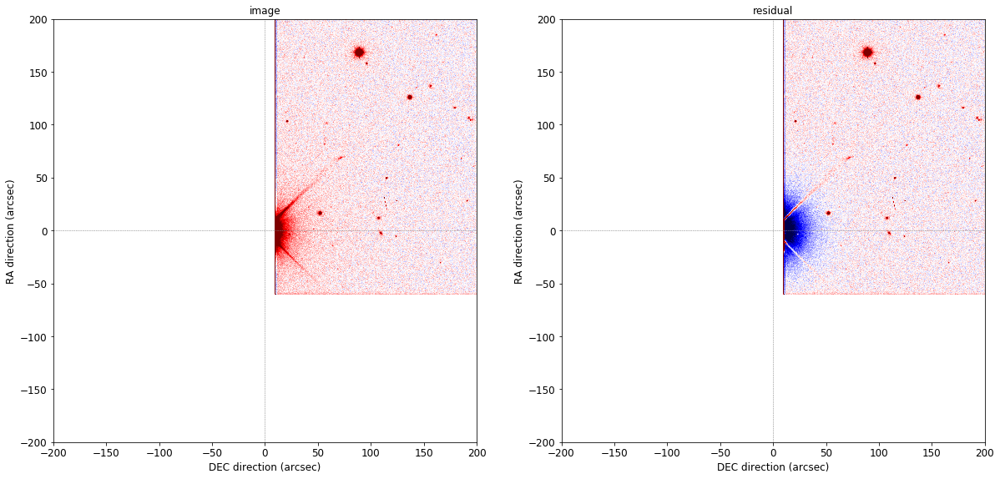

175.232973949 -0.674426135434
9   phot_g_mean_mag=6.765   ls_z=6.089
2 CCD images available
alpha, beta = 0.458, 2.049
Exposure: 725147  CCD: S28


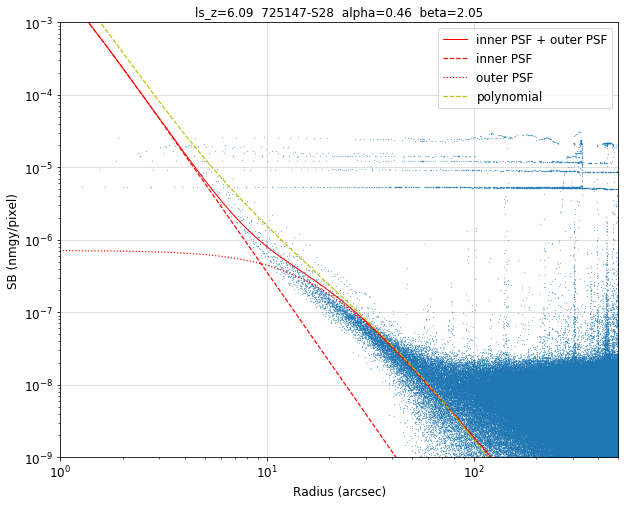

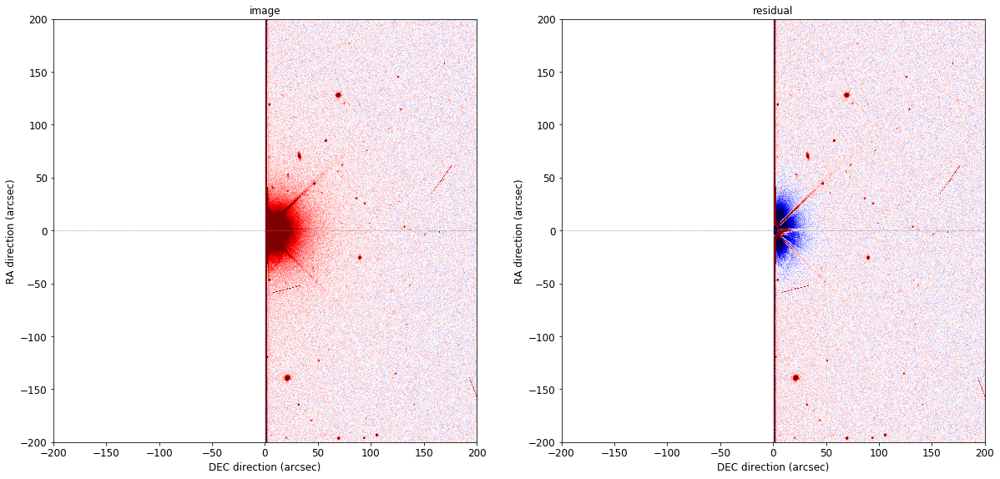

175.232973949 -0.674426135434
9   phot_g_mean_mag=6.765   ls_z=6.089
2 CCD images available
alpha, beta = 0.458, 2.049
Exposure: 725147  CCD: S28


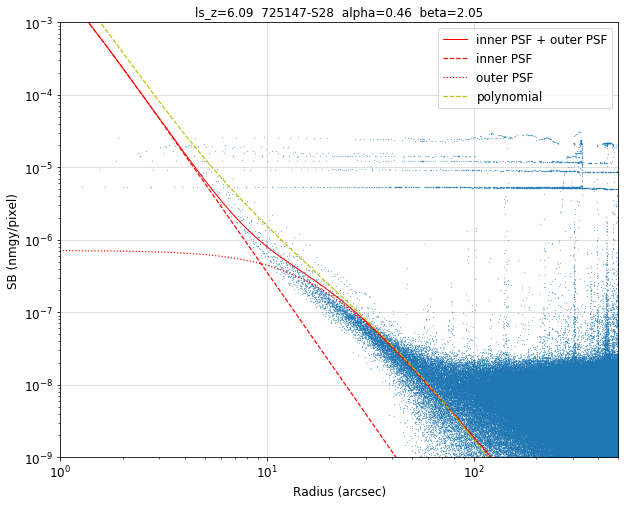

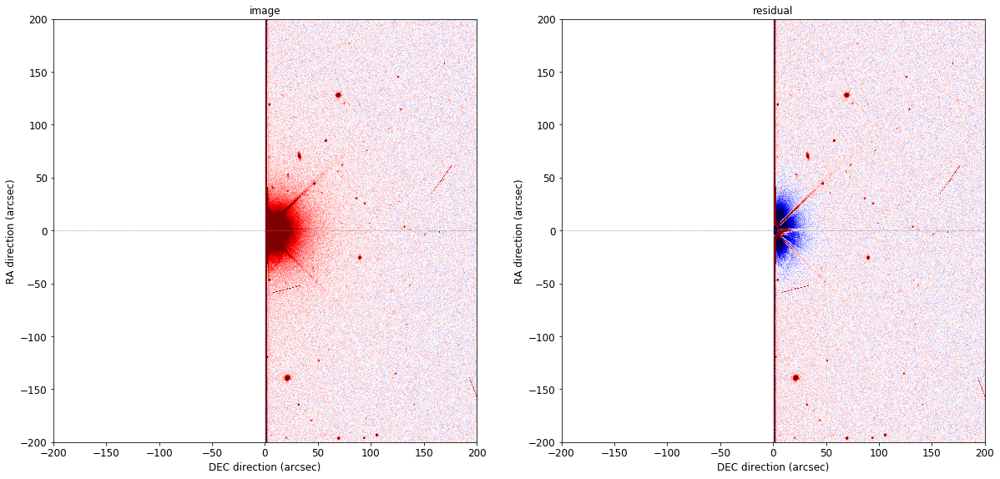

160.632119618 18.2198444476
15   phot_g_mean_mag=6.810   ls_z=6.278
1 CCD images available
alpha, beta = 0.429, 1.872
Exposure: 520556  CCD: S12


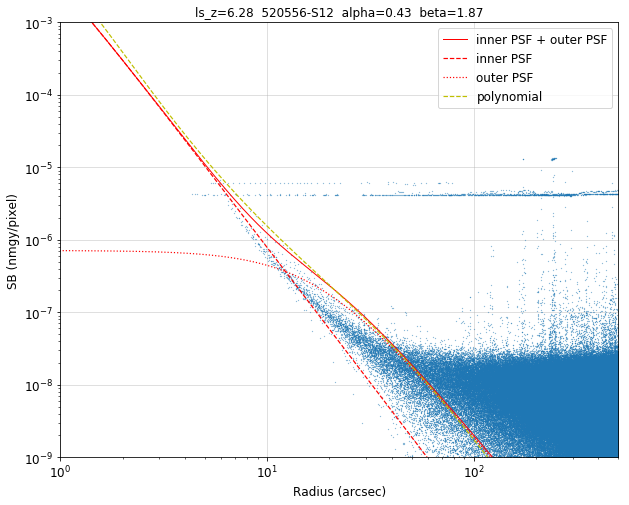

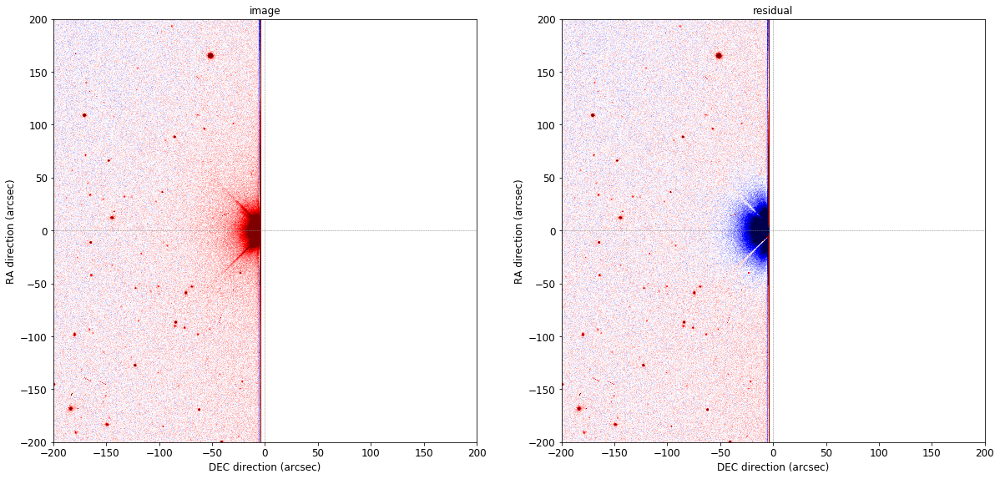

174.319799847 -0.578024626168
22   phot_g_mean_mag=7.406   ls_z=6.848
2 CCD images available
alpha, beta = 0.354, 1.954
Exposure: 719391  CCD: S30


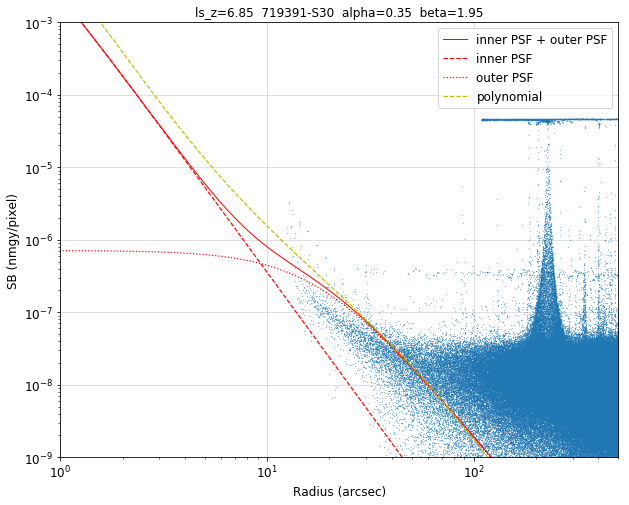

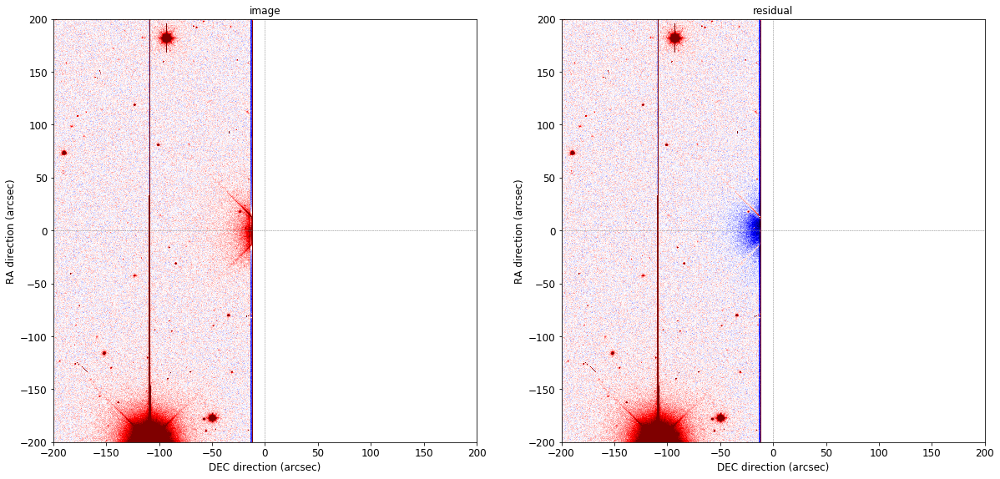

174.319799847 -0.578024626168
22   phot_g_mean_mag=7.406   ls_z=6.848
2 CCD images available
alpha, beta = 0.354, 1.954
Exposure: 719391  CCD: S30


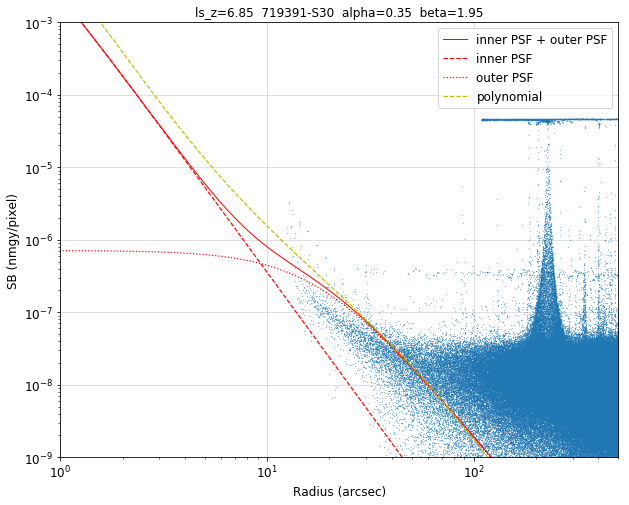

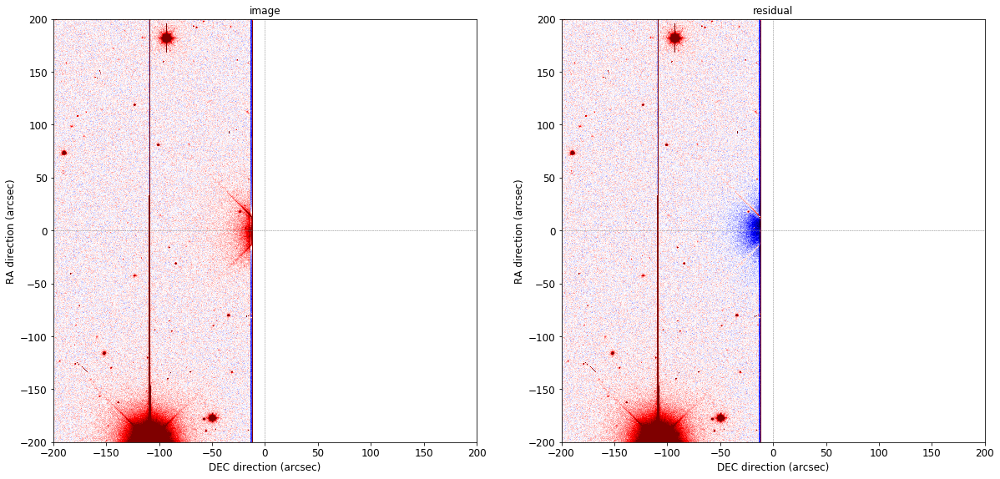

192.200262514 13.3238330687
24   phot_g_mean_mag=7.423   ls_z=6.691
1 CCD images available
alpha, beta = 0.610, 1.908
Exposure: 431199  CCD: S19


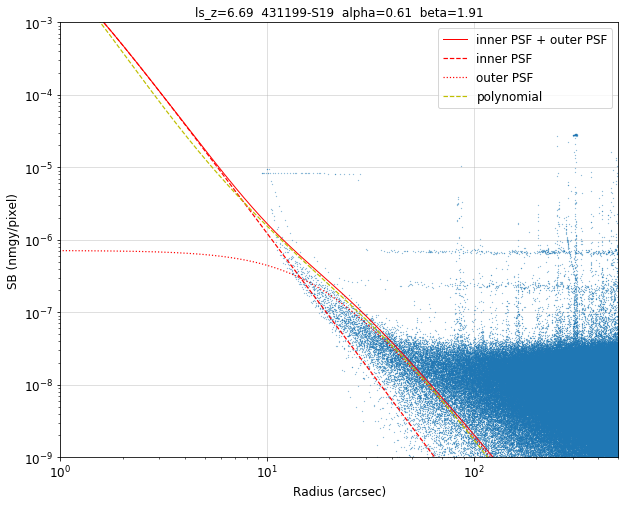

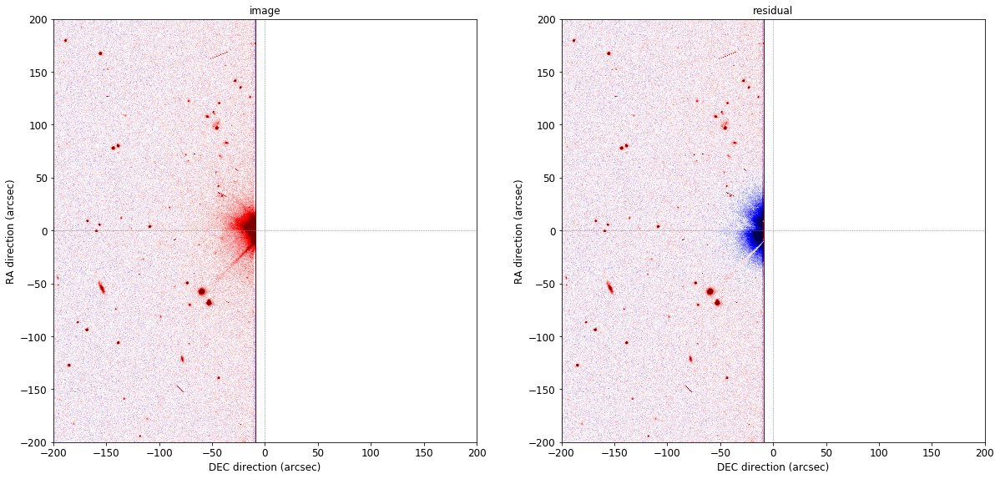

161.673296286 16.5428995439
25   phot_g_mean_mag=7.190   ls_z=6.523
1 CCD images available
alpha, beta = 0.472, 2.049
Exposure: 520938  CCD: S5 


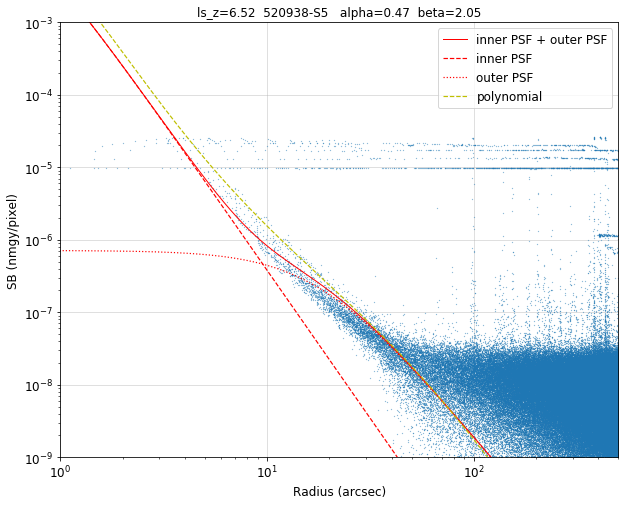

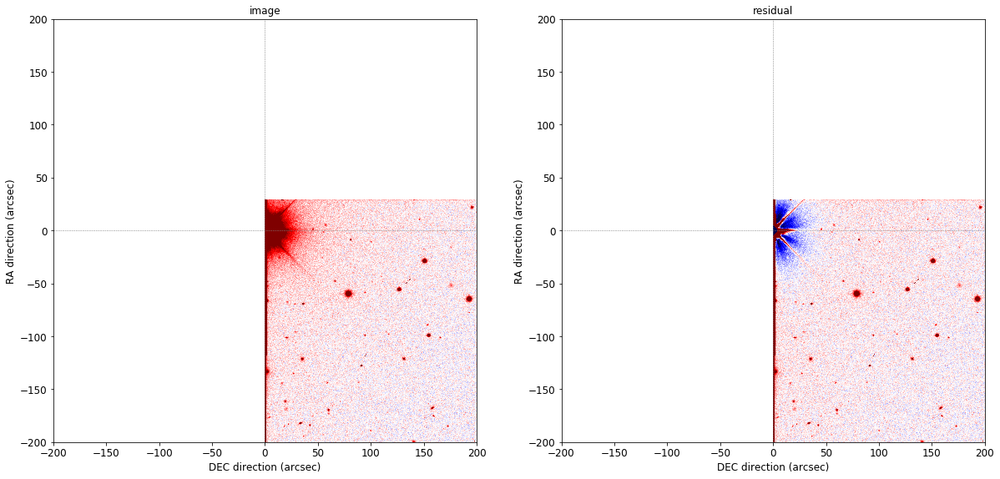

181.290421842 13.4728963706
26   phot_g_mean_mag=7.094   ls_z=6.248
1 CCD images available
alpha, beta = 0.483, 1.991
Exposure: 607999  CCD: N17


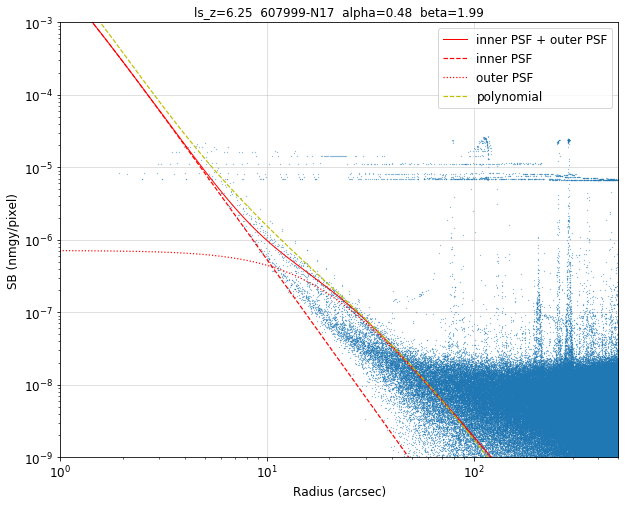

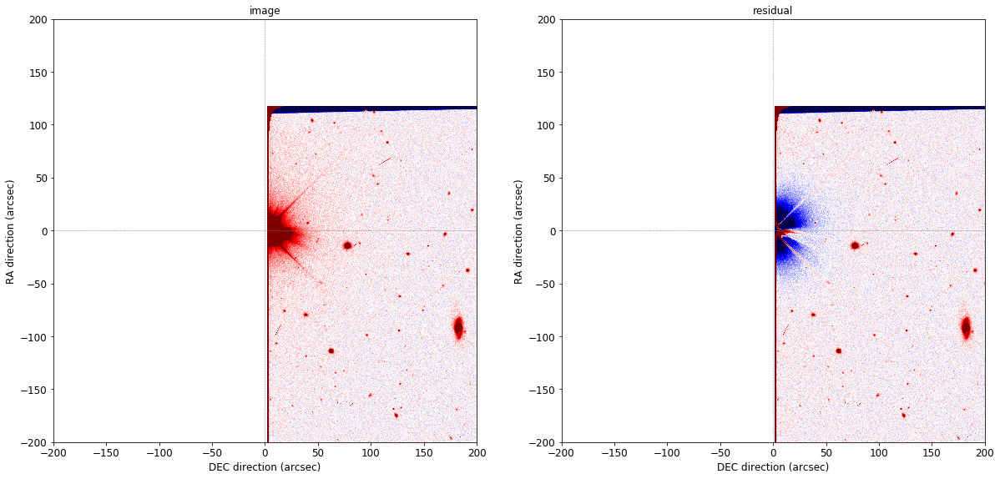

202.068438055 2.23582803913
27   phot_g_mean_mag=7.092   ls_z=6.607
1 CCD images available
alpha, beta = 0.941, 2.217
Exposure: 563039  CCD: N28


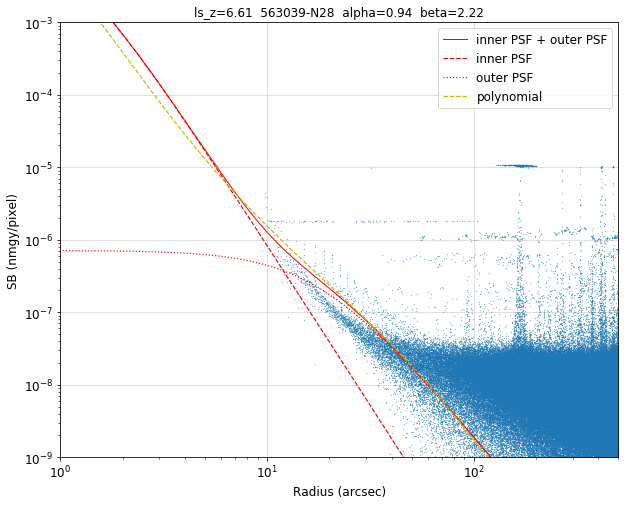

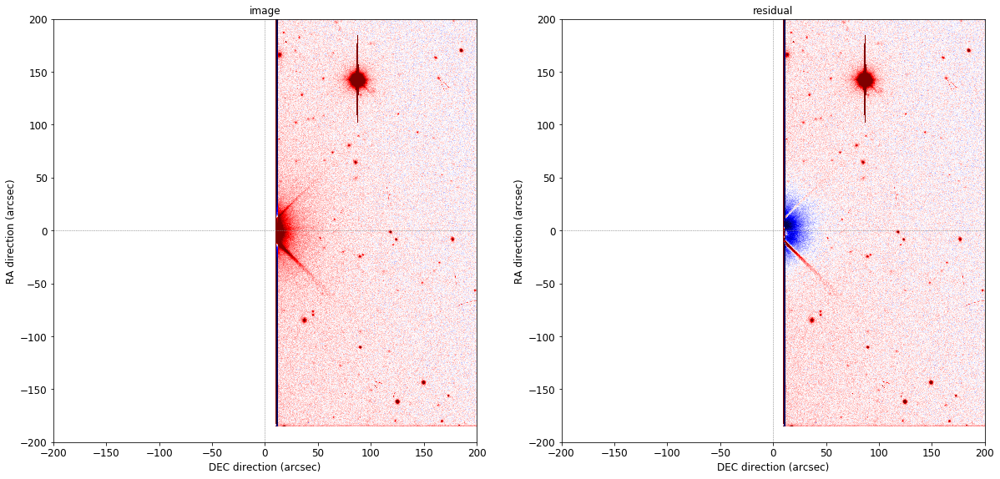

175.121959182 5.13994240745
28   phot_g_mean_mag=7.396   ls_z=7.315
1 CCD images available
alpha, beta = 1.054, 2.397
Exposure: 648015  CCD: N14


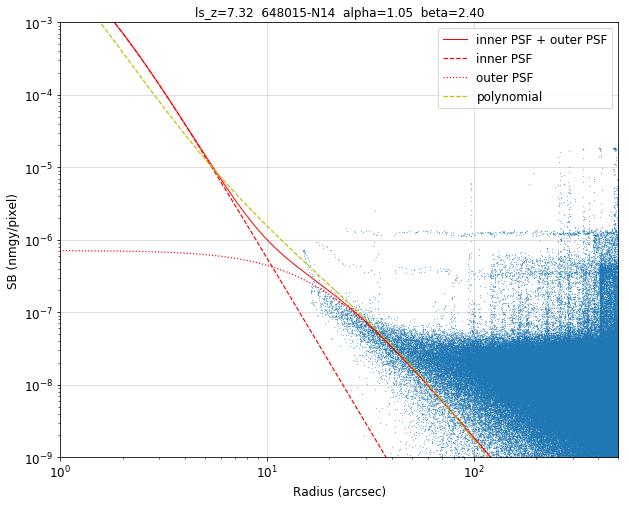

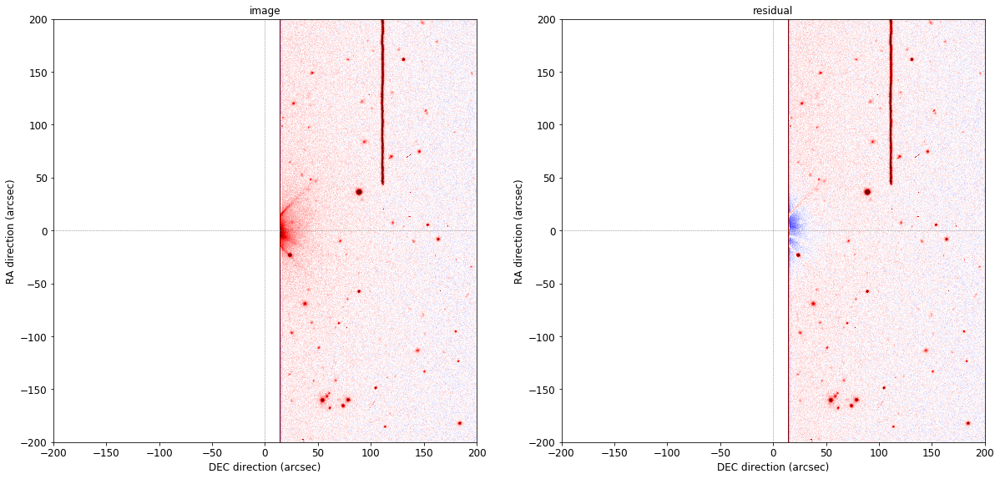

162.484650903 -1.95903150534
39   phot_g_mean_mag=7.452   ls_z=6.378
2 CCD images available
alpha, beta = 0.420, 1.936
Exposure: 725143  CCD: N17


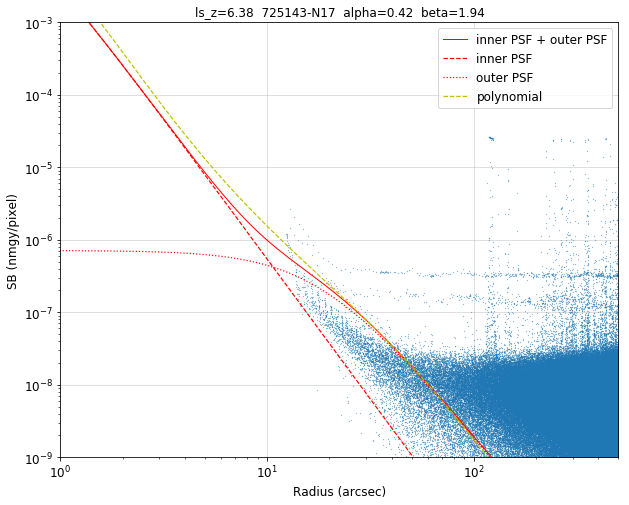

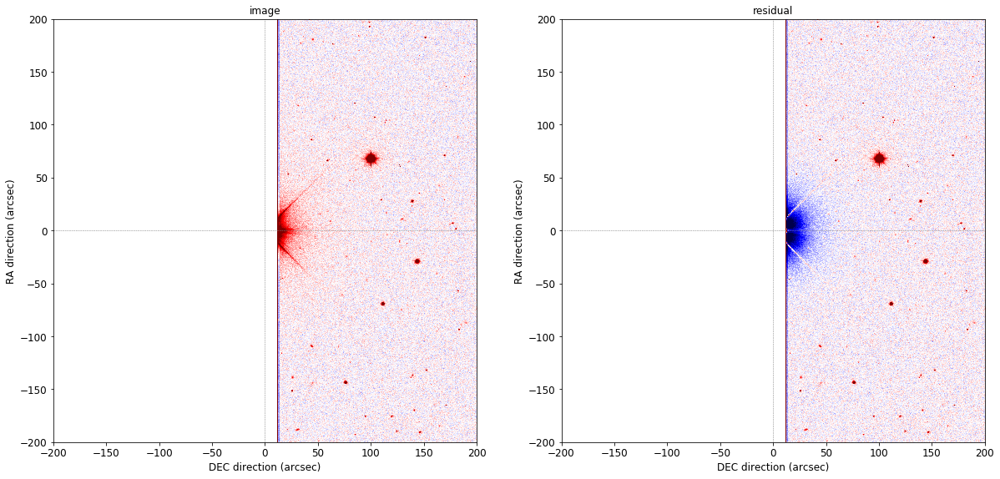

162.484650903 -1.95903150534
39   phot_g_mean_mag=7.452   ls_z=6.378
2 CCD images available
alpha, beta = 0.420, 1.936
Exposure: 725143  CCD: N17


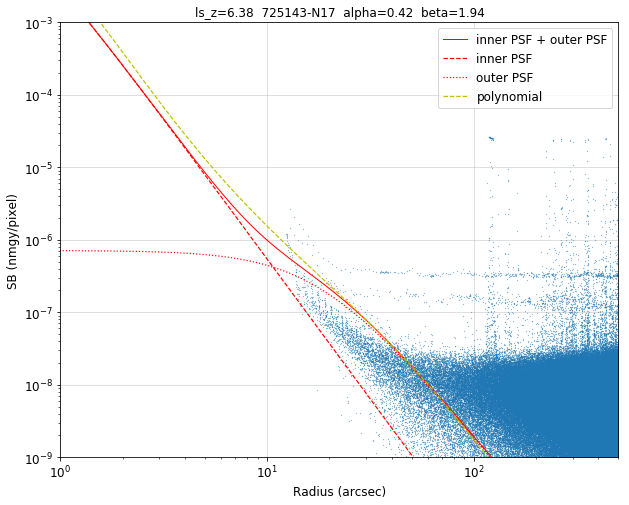

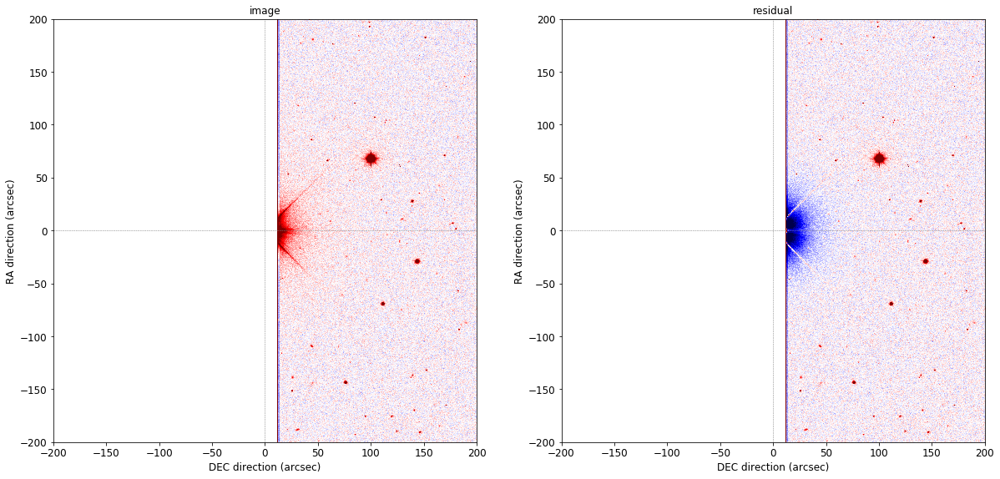

170.20135508 2.8622515413
42   phot_g_mean_mag=7.823   ls_z=7.402
1 CCD images available
alpha, beta = 0.582, 2.108
Exposure: 426038  CCD: N5 


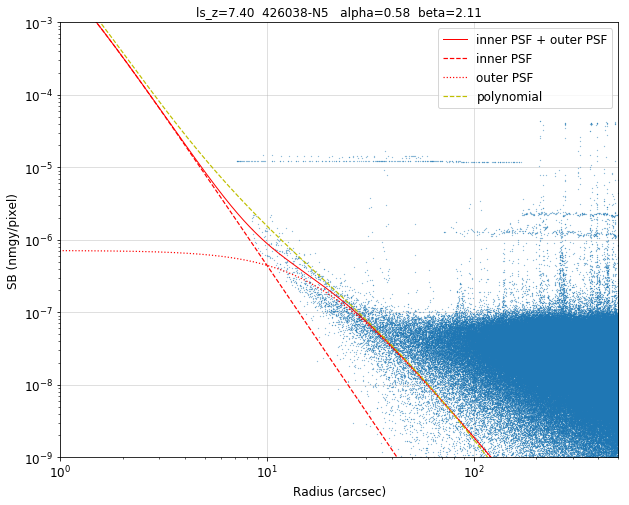

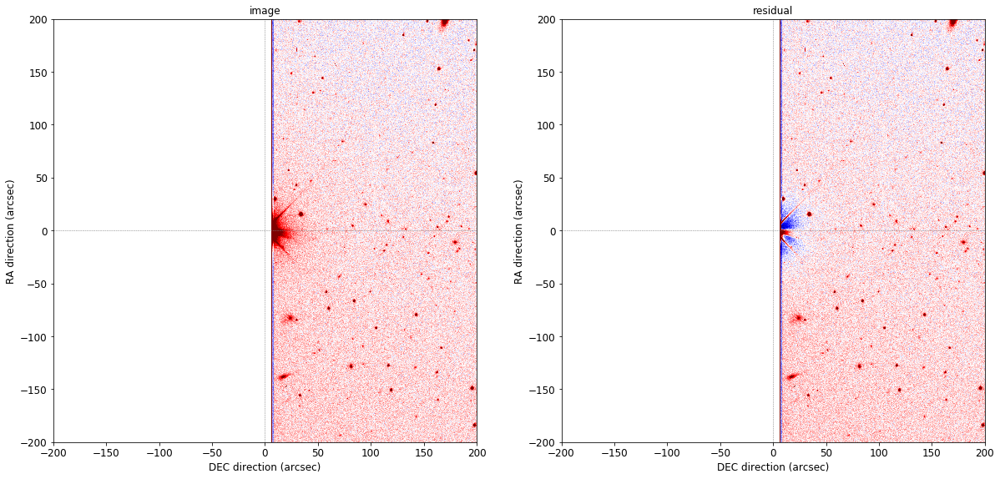

188.888456238 15.6363486245
43   phot_g_mean_mag=7.587   ls_z=6.824
1 CCD images available
alpha, beta = 0.330, 1.800
Exposure: 631019  CCD: S12


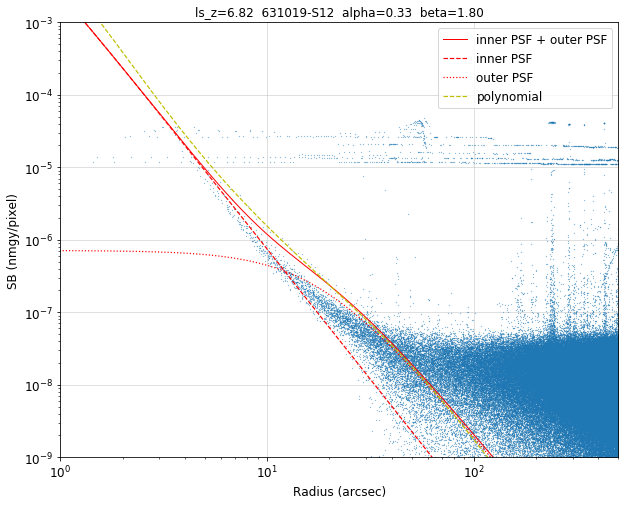

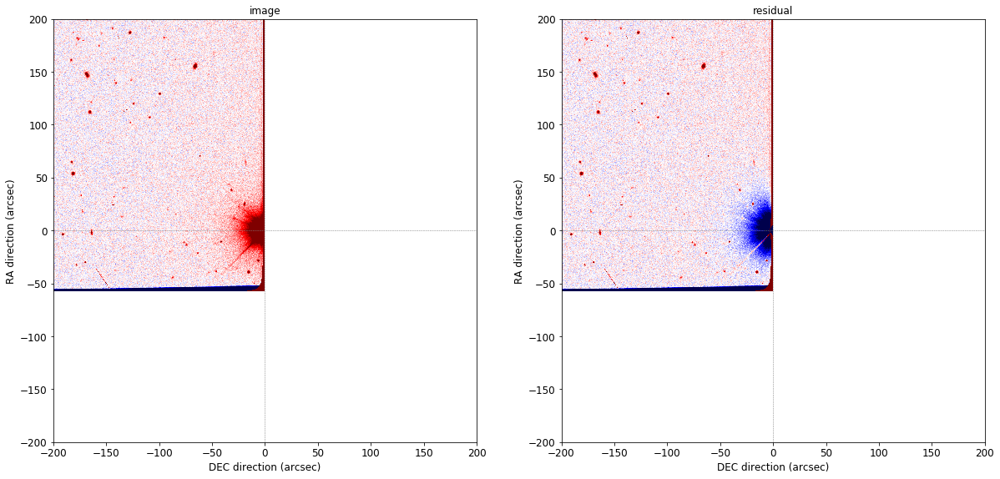

193.14204505 1.94366697419
46   phot_g_mean_mag=7.597   ls_z=7.163
2 CCD images available
alpha, beta = 0.604, 2.024
Exposure: 426126  CCD: S17


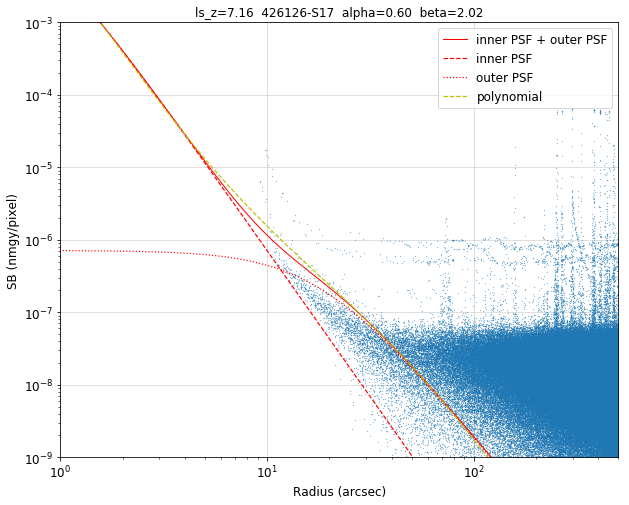

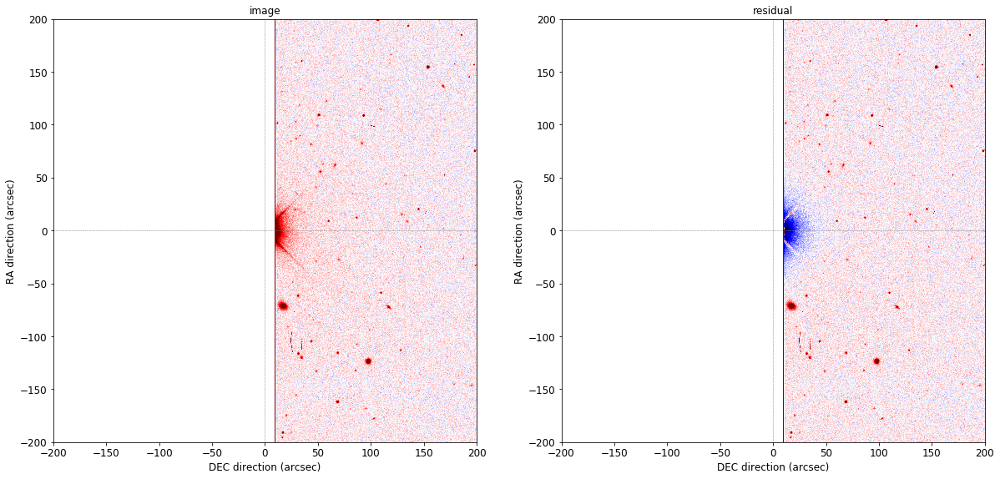

193.14204505 1.94366697419
46   phot_g_mean_mag=7.597   ls_z=7.163
2 CCD images available
alpha, beta = 0.604, 2.024
Exposure: 426126  CCD: S17


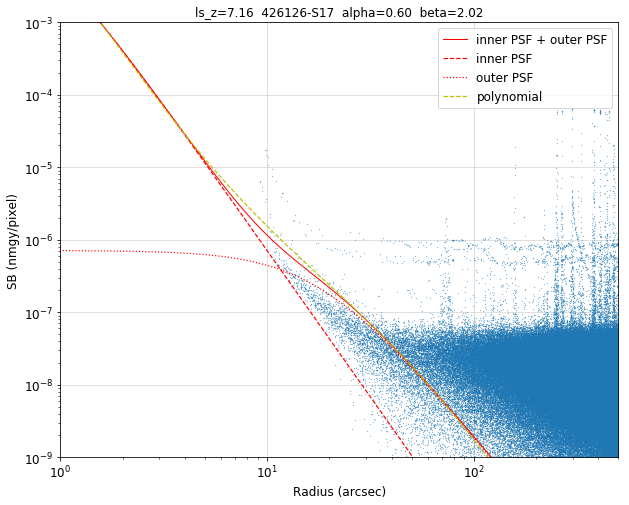

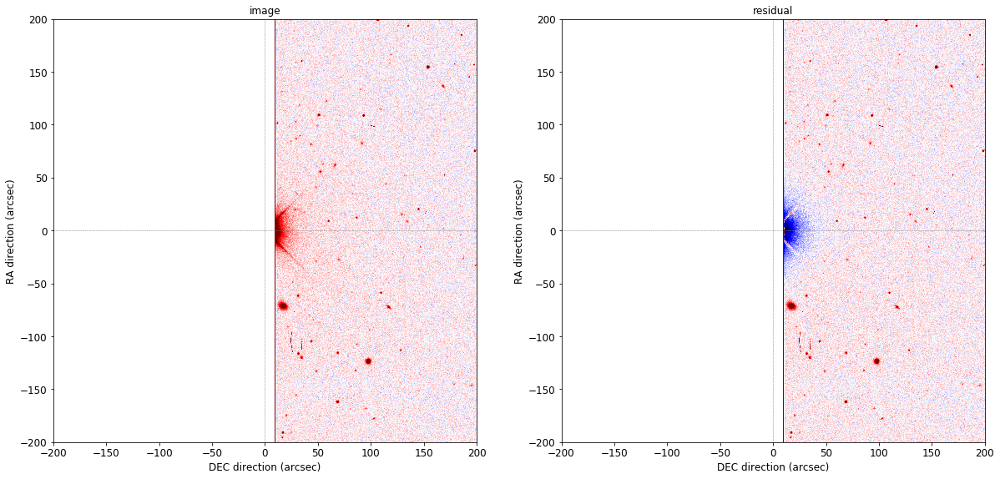

208.994235696 13.7492953858
55   phot_g_mean_mag=7.577   ls_z=6.680
2 CCD images available
alpha, beta = 0.757, 2.187
Exposure: 820253  CCD: N2 


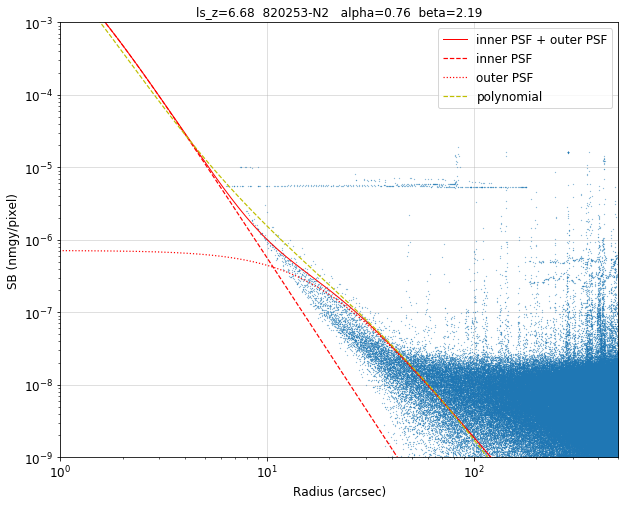

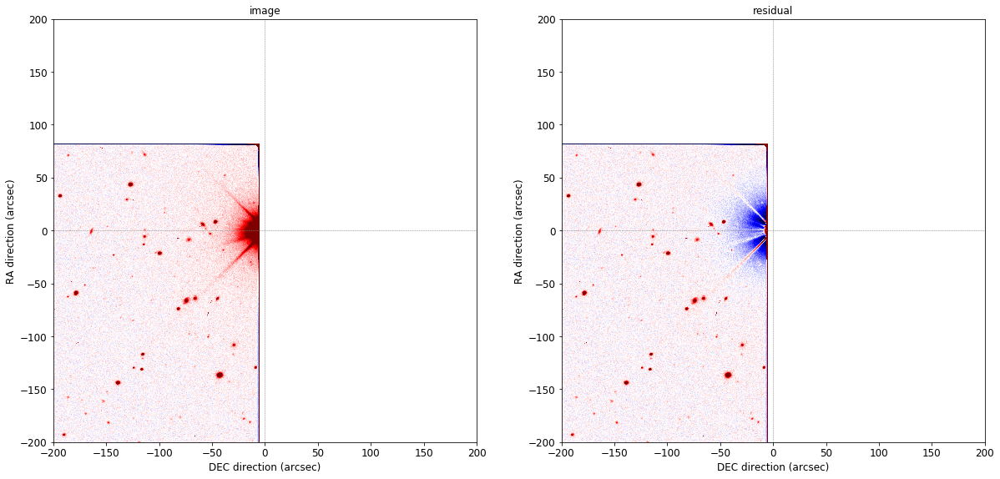

208.994235696 13.7492953858
55   phot_g_mean_mag=7.577   ls_z=6.680
2 CCD images available
alpha, beta = 0.757, 2.187
Exposure: 820253  CCD: N2 


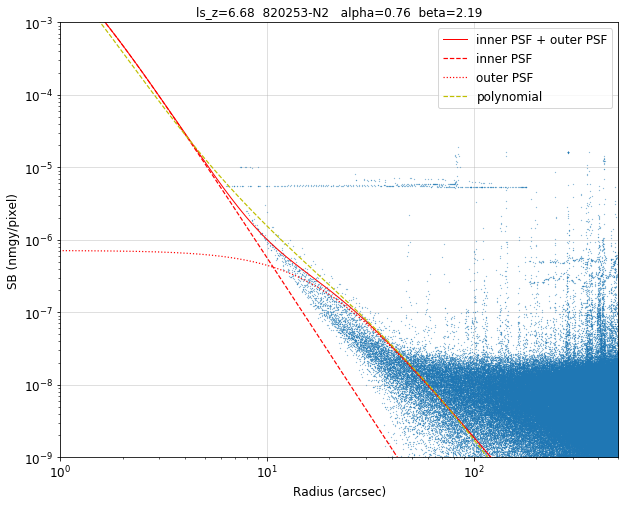

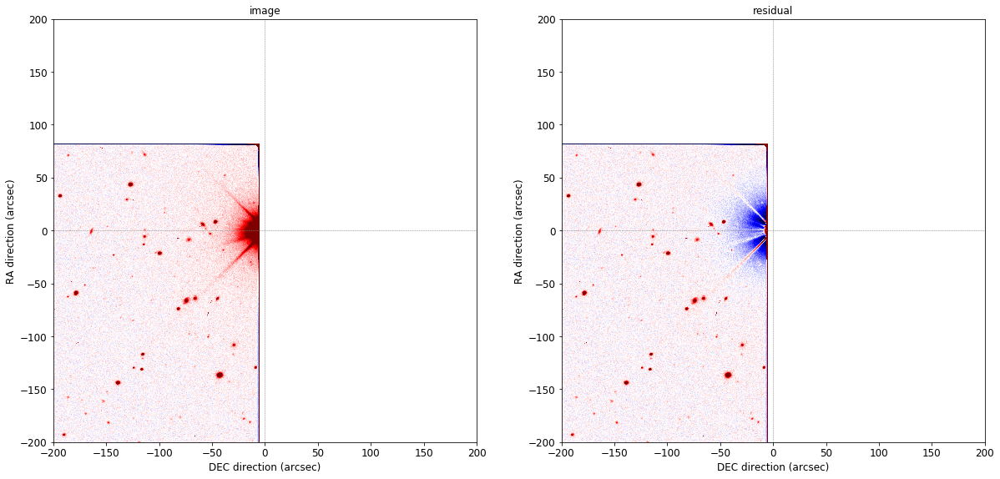

163.057316886 13.0989219689
70   phot_g_mean_mag=8.202   ls_z=7.707
1 CCD images available
alpha, beta = 0.644, 2.140
Exposure: 625992  CCD: N9 


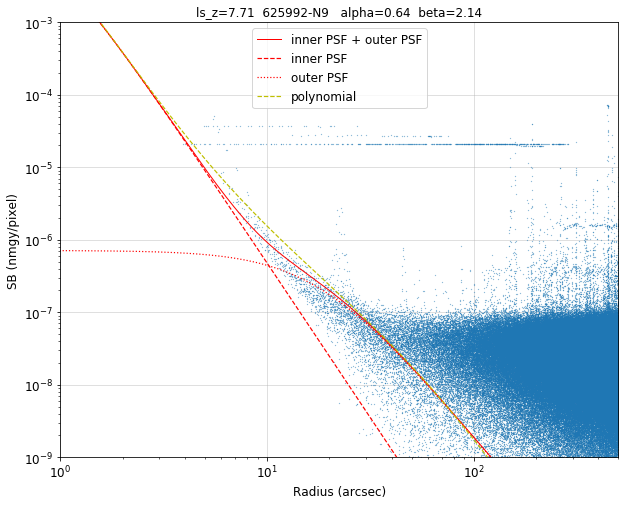

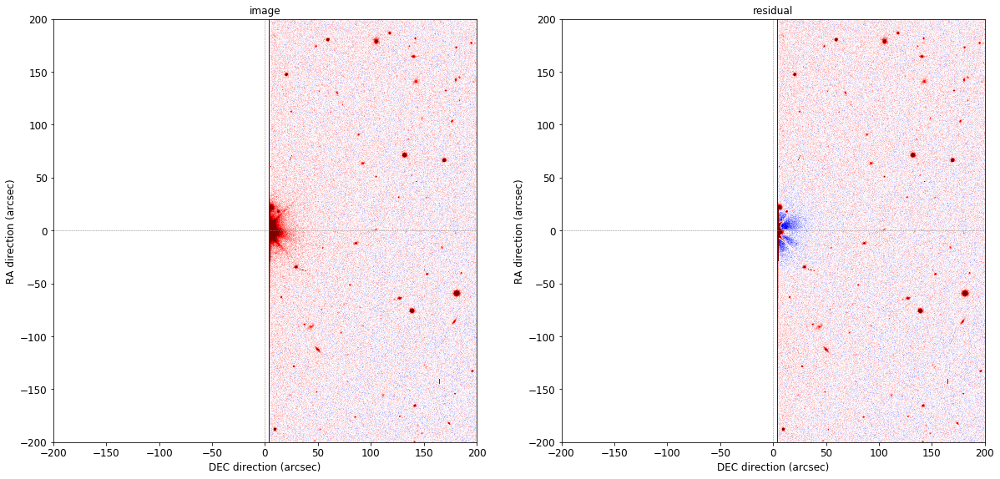

205.204294847 2.11437626788
76   phot_g_mean_mag=8.458   ls_z=7.812
1 CCD images available
alpha, beta = 0.438, 2.084
Exposure: 647367  CCD: N31


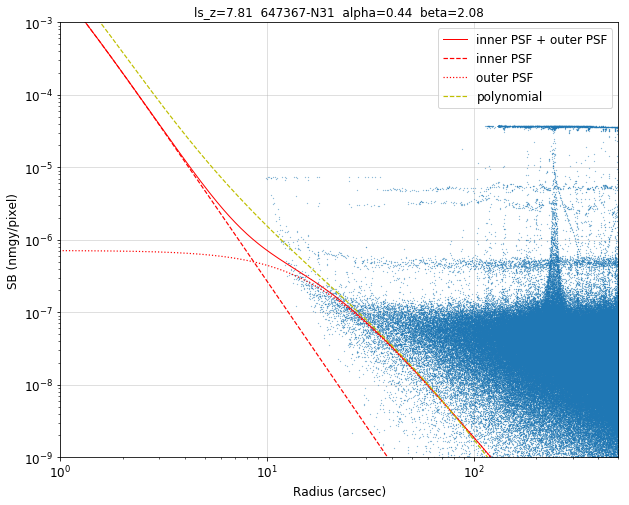

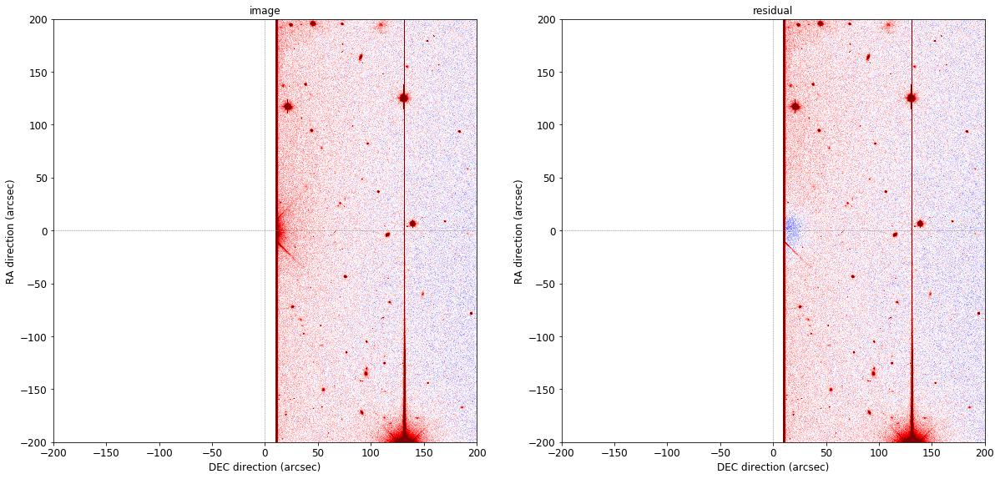

192.447181304 18.342915675
83   phot_g_mean_mag=8.512   ls_z=8.106
1 CCD images available
alpha, beta = 0.413, 1.947
Exposure: 631033  CCD: N17


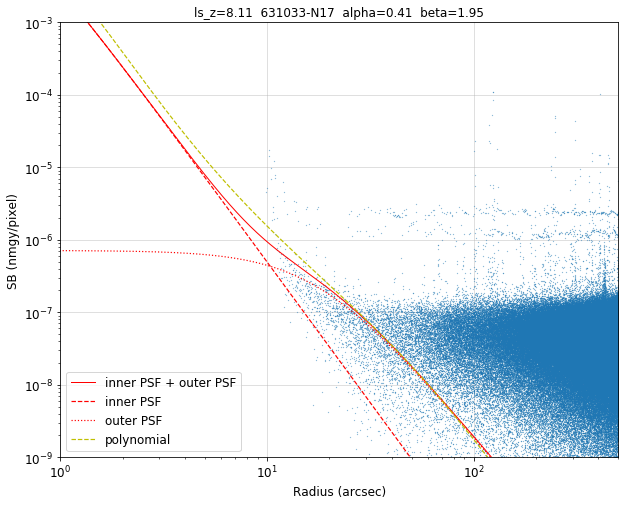

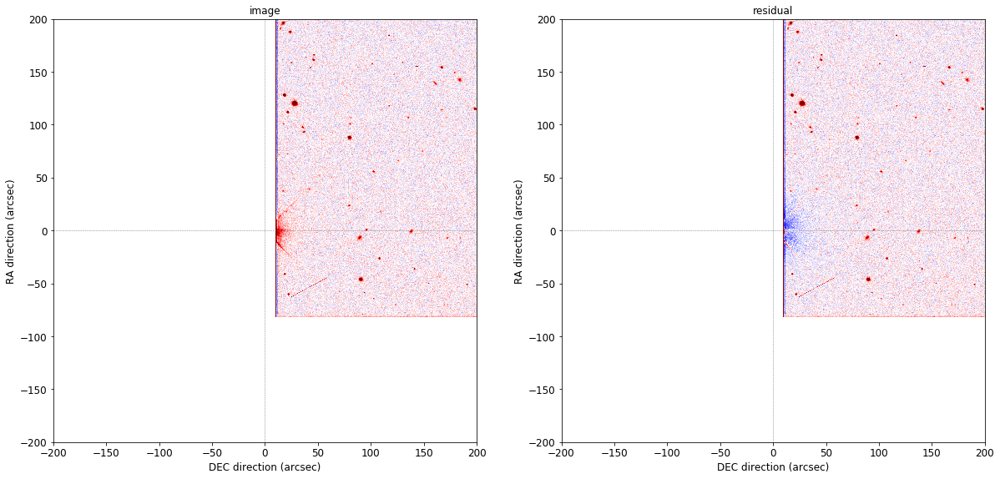

204.471654995 -2.08928027852
87   phot_g_mean_mag=8.535   ls_z=8.442
2 CCD images available
alpha, beta = 0.777, 2.204
Exposure: 396125  CCD: N19


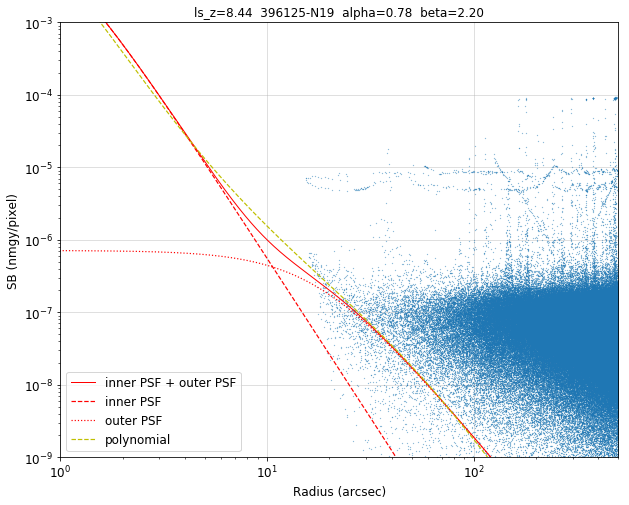

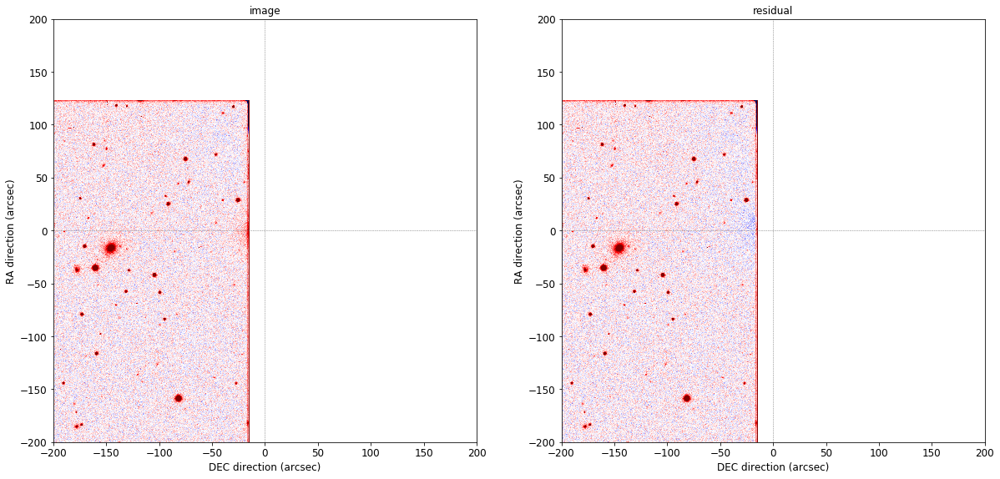

In [10]:
mask = (np.abs(d_ra)<max_d_ra)
mask &= (np.abs(d_dec)>1.0*max_d_dec) & (np.abs(d_dec)<1.07*max_d_dec)
print(np.sum(mask))
mask &= ccd['filter'][idx2_all]==band
print(np.sum(mask))
idx1 = idx1_all[mask]
idx2 = idx2_all[mask]

for idx1_index in range(len(idx1)//2):
    gaia_index = idx1[idx1_index]
    ccd1_index = 0

    gaia_mask = idx1==gaia_index
    if np.sum(gaia_mask)==0:
        raise ValueError

    ra, dec = gaia['ra'][gaia_index], gaia['dec'][gaia_index]
    print(ra, dec)
    print('{}   phot_g_mean_mag={:.3f}   ls_{}={:.3f}'.format(gaia_index, gaia['phot_g_mean_mag'][gaia_index], band, gaia['ls_'+band][gaia_index]))

    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        ccd1 = ccd[idx2[gaia_mask]]
        print(len(ccd1), 'CCD images available')
        
        for ccd1_index in range(len(ccd1)):

            expnum_str = str(ccd1['expnum'][ccd1_index])
            ccdname = ccd1['ccdname'][ccd1_index]
            fn_prefix = ccd1['camera'][ccd1_index]+'-'+(5-len(expnum_str[:3]))*'0'+expnum_str+'-'+ccdname
            # print(fn_prefix)
            # print('seeing = {:.2f} arcsec'.format(ccd1['seeing'][ccd1_index]))
            # print('airmass = {:.2f}'.format(ccd1['airmass'][ccd1_index]))

            if band=='z' and (ccdname in outlier_ccd_list):
                params_to_use = params_outlier
            else:
                params_to_use = params

            if band!='z':
                plexp2, weight2 = params_to_use[band+'_plexp2'], params_to_use[band+'_weight2']
            else:
                alpha2, beta2, weight2 = params_to_use[band+'_alpha2'], params_to_use[band+'_beta2'],  params_to_use[band+'_weight2']

            ########## PSFEx ###########
            image_filename = ccd1['image_filename'][ccd1_index]
            psfex_filename = image_filename[:image_filename.find('.fits.fz')]+'-psfex.fits'
            psfex_fn = os.path.join('/project/projectdirs/cosmo/work/legacysurvey/dr9/calib', psfex_filename)

            hdu = fits.open(psfex_fn)
            data = hdu[1].data
            psfex_index = np.where(data['ccdname']==ccdname)[0][0]

            psf0 = data['psf_mask'][psfex_index, 0]
            # normalize to a 22.5 magnitude star
            psf0 = psf0/np.sum(psf0)

            # vrange = 0.0002
            # ax = plot_cutout(psf0, pixscale, vmin=-vrange, vmax=vrange, axis_label=['DEC direction (arcsec)', 'RA direction (arcsec)'])
            # plt.show()

            grid = pixscale * np.linspace(-0.5*(psf0.shape[0]-1), 0.5*(psf0.shape[0]-1), psf0.shape[0])
            xx, yy = np.meshgrid(grid, grid)
            radius_grid = np.sqrt(xx**2 + yy**2)
            radius = radius_grid.flatten()

            ################# Moffat fit ##############

            radius_min, radius_max = 1.8, 5.0

            psf0_flat = psf0.flatten()
            with warnings.catch_warnings():
                warnings.simplefilter("ignore")
                # popt, pcov =  curve_fit(get_sb_moffat, radius, psf0_flat/(pixscale**2))
                mask = (radius>radius_min) & (radius<radius_max)
                popt, pcov = curve_fit(get_sb_moffat, radius[mask], psf0_flat[mask]/(pixscale**2), bounds=((0, 1.8), np.inf))

            alpha, beta = popt
            print('alpha, beta = {:.3f}, {:.3f}'.format(alpha, beta))

            radius_plot = np.linspace(0, 30, 500)
            if band!='z':
                psf_predict = pixscale**2 * get_sb_moffat_plus_power_law(radius_grid, alpha, beta, plexp2, weight2)
                psf_plot = pixscale**2 * get_sb_moffat_plus_power_law(radius_plot, alpha, beta, plexp2, weight2)
                psf_plot1 = pixscale**2 * get_sb_moffat(radius_plot, alpha, beta)
                psf_plot2 = weight2 * pixscale**2 * radius_plot**(plexp2)
            else:
                psf_predict = pixscale**2 * get_sb_double_moffat(radius_grid, alpha, beta, alpha2, beta2, weight2)
                psf_plot = pixscale**2 * get_sb_double_moffat(radius_plot, alpha, beta, alpha2, beta2, weight2)
                psf_plot1 = pixscale**2 * get_sb_moffat(radius_plot, alpha, beta)
                psf_plot2 = weight2 * pixscale**2 * get_sb_moffat(radius_plot, alpha2, beta2)

            # with warnings.catch_warnings():
            #     warnings.simplefilter("ignore")
            #     plt.figure(figsize=(8, 6))
            #     plt.loglog(radius, psf0_flat, '.', ms=1.)
            #     plt.loglog(radius_plot, psf_plot, 'C1-', lw=1, label='inner PSF + outer PSF')
            #     plt.loglog(radius_plot, psf_plot1, 'C1--', lw=1.2, alpha=1., label='inner PSF')
            #     plt.loglog(radius_plot, psf_plot2, 'C1:', lw=1.2, alpha=1., label='outer PSF')
            #     mask = radius_plot>0.5
            #     plt.loglog(radius_plot[mask], 10**(profile_fit(np.log10(radius_plot)))[mask], 'C2--', lw=1.2, label='polynomial')
            #     plt.axis([0.2, 10, 3e-7, 0.05])
            #     plt.grid(alpha=0.5)
            #     plt.xlabel('Radius (arcsec)')
            #     plt.ylabel('SB (nmgy/pixel)')
            #     plt.title('{}-{}  alpha={:.3f}  beta={:.3f}'.format(expnum_str, ccdname, alpha, beta))
            #     plt.legend()
            #     # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_psfex.png'.format(band, band, gaia_index, ccd1_index, ccdname))
            #     plt.show()

            ######################################################

            image_dir = '/global/project/projectdirs/cosmo/staging/'
            fn = os.path.join(image_dir, ccd1['image_filename'][ccd1_index]).strip()
            # print(fn)

            hdulist = fits.open(fn)
            # print(hdu[ccd1['image_hdu'][ccd1_index]].header)
            img_raw = hdulist[ccd1['image_hdu'][ccd1_index]].data

            # naive sky subtraction
            mask = (img_raw<np.percentile(img_raw.flatten(), 85))
            img = img_raw - np.median(img_raw[mask].flatten())
            # convert to nanomaggie per pixel
            img = img / 10**((ccd1['ccdzpt'][ccd1_index]-22.5)/2.5) / ccd1['exptime'][ccd1_index]

            # plt.hist(img.flatten(), 100, range=(-0.02, 0.02))
            # plt.axvline(0, color='red')
            # plt.show()

            xgrid = pixscale * np.linspace(-0.5*(img.shape[1]-1), 0.5*(img.shape[1]-1), img.shape[1])
            ygrid = pixscale * np.linspace(-0.5*(img.shape[0]-1), 0.5*(img.shape[0]-1), img.shape[0])
            xx, yy = np.meshgrid(xgrid, ygrid)

            # astrometric correction
            ccdraoff, ccddecoff = -ccd1['ccdraoff'][ccd1_index], -ccd1['ccddecoff'][ccd1_index]

            w = wcs.WCS(hdulist[ccd1['image_hdu'][ccd1_index]].header)
            xpixcenter, ypixcenter = w.wcs_world2pix([[ra, dec]], True)[0]
            # if (xpixcenter<0) or (ypixcenter<0) or (xpixcenter>img.shape[1]) or (ypixcenter>img.shape[0]):
            #     raise ValueError ('outside the CCD!!!')
                # print('outside the CCD!!!')
                # continue

            print('Exposure: {}  CCD: {}'.format(expnum_str, ccdname))

            ccddecoff += pixscale*(xpixcenter-(img.shape[1]/2+0.5))
            ccdraoff += pixscale*(ypixcenter-(img.shape[0]/2+0.5))

            xx, yy = xx - ccddecoff, yy - ccdraoff

            radius_grid = np.sqrt(xx**2 + yy**2)
            radius = radius_grid.flatten()
            radius_plot = np.logspace(-1, 3, 1000)
            flux = img.flatten()
            # normalization of a 22.5 magnitude star
            norm_factor =  10**((gaia['ls_'+band][gaia_index]-22.5)/2.5)

            if band!='z':
                img_predict = pixscale**2 * get_sb_moffat_plus_power_law(radius_grid, alpha, beta, plexp2, weight2) / norm_factor
                flux_plot = pixscale**2 * get_sb_moffat_plus_power_law(radius_plot, alpha, beta, plexp2, weight2)
                flux_plot1 = pixscale**2 * get_sb_moffat(radius_plot, alpha, beta)
                flux_plot2 = weight2 * pixscale**2 * radius_plot**(plexp2)
            else:
                img_predict = pixscale**2 * get_sb_double_moffat(radius_grid, alpha, beta, alpha2, beta2, weight2) / norm_factor
                flux_plot = pixscale**2 * get_sb_double_moffat(radius_plot, alpha, beta, alpha2, beta2, weight2)
                flux_plot1 = pixscale**2 * get_sb_moffat(radius_plot, alpha, beta)
                flux_plot2 = weight2 * pixscale**2 * get_sb_moffat(radius_plot, alpha2, beta2)

            # plt.figure(figsize=(20, 10))
            # plt.imshow(img.T, cmap='seismic', vmin=-vrange, vmax=vrange)
            # # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_img.png'.format(band, band, gaia_index, ccd1_index, ccdname))
            # plt.show()

            # plt.figure(figsize=(20, 10))
            # plt.imshow((img-img_predict).T, cmap='seismic', vmin=-vrange, vmax=vrange)
            # # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_img_subtr.png'.format(band, band, gaia_index, ccd1_index, ccdname))
            # plt.show()

            mask = radius<500
            plt.figure(figsize=(10, 8))
            plt.loglog((radius[mask])[::10], norm_factor*(flux[mask])[::10], '.', ms=0.4)
            plt.loglog(radius_plot, flux_plot, 'r-', lw=1, label='inner PSF + outer PSF')
            plt.loglog(radius_plot, flux_plot1, 'r--', lw=1.2, alpha=1., label='inner PSF')
            plt.loglog(radius_plot, flux_plot2, 'r:', lw=1.2, alpha=1., label='outer PSF')
            mask = radius_plot>0.5
            plt.loglog(radius_plot[mask], 10**(profile_fit(np.log10(radius_plot[mask]))), 'y--', lw=1.2, label='polynomial')
            plt.axis([1, 500, 1e-9, 1e-3])
            plt.grid(alpha=0.5)
            plt.title('ls_{}={:.2f}  {}-{}  alpha={:.2f}  beta={:.2f}'.format(band, gaia['ls_'+band][gaia_index], expnum_str, ccdname, alpha, beta))
            plt.xlabel('Radius (arcsec)')
            plt.ylabel('SB (nmgy/pixel)')
            plt.legend()
            # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_profile.png'.format(band, band, gaia_index, ccd1_index, ccdname))
            plt.show()

            ax = plot_cutout_sidebyside(img, img-img_predict, pixscale, decraoff=[ccddecoff, ccdraoff], vmin=-vrange, vmax=vrange, axis_label=['DEC direction (arcsec)', 'RA direction (arcsec)'], axis=[-200, 200, -200, 200], title1='image', title2='residual')
            # plt.savefig('/global/homes/r/rongpu/temp/plots/bright_star_profile/decals_{}_new/{}_{}_{}_{}_sidebyside.png'.format(band, band, gaia_index, ccd1_index, ccdname))
            plt.show()